# Laboratorio 3 - Redes Convolucionales - Diplomado Inteligencia Artificial UC
En este laboratorio exploraremos técnicas de visualización en redes neuronales, tanto de sus representaciones internas (feature visualization) como qué partes del input son responsables del output (attribution).

Nombre: Ariel Carvajal

Necesitaremos algunas funcionalidades nuevas de la librería `matplotlib`, así que lo primero que haremos será actualizarla. Después de la actualización es necesario reiniciar el runtime.

In [19]:
!pip install -U matplotlib

## Feature visualization
Consiste en visualizar qué inputs maximizan la respuesta de algún componente de interés de una red neuronal. Estos componentes pueden ser neuronas, mapas de activación, capas o la clasificación final de la red.

Primero, visualizaremos los features de algunas arquitecturas conocidas como Alexnet, VGG, Resnet e Inception entrenadas en el dataset de ImageNet.

### Modelos preentrenados
Pytorch nos permite utilizar estos modelos directamente y además nos ofrece la posibilidad de descargar los pesos de los modelos entrenados en ImageNet. Para ello debemos utilizar *torchvision*, una libería de pytorch enfocada en el trabajo con imágenes.

In [17]:
import torch
import torchvision.models as models # torchvision.models contiene varios modelos interesantes

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu") # variable para enviar los datos a CPU o GPU

alexnet = models.alexnet(pretrained=True).to(device).eval()     # descargamos Alexnet
                                                                # el parámetro pretrained=True hará que se descarguen los pesos del modelo entrenado en Imagenet
                                                                # luego enviamos el modelo a la CPU o GPU según la variable device
                                                                # finalmente dejamos el modelo en modo evaluación con eval()

googlenet = models.googlenet(pretrained=True).to(device).eval() # GoogLeNet corresponde a Inception v1

vgg19 = models.vgg19(pretrained=True).to(device).eval()
resnet50 = models.resnet50(pretrained=True).to(device).eval()

Ahora que tenemos nuestros modelos en pytorch visualizaremos sus representaciones internas en distintas capas. Para ellos utilizaremos la librería **torch-lucent**, que implementa el algoritmo de optimización de input que vimos durante la clase. La librería también implementa las técnicas de regularización que permiten que el resultado se parezca más a una imagen y no a ruido.

In [21]:
!pip install torch-lucent

In [24]:
from lucent.optvis import render, param, transform, objectives # importamos los módulos que usaremos para visualizar los features
from lucent.modelzoo.util import get_model_layers # esta función nos permite ver el nombre de las capas de un modelo

#### Alexnet
Veamos los elementos de la red AlexNet que importamos desde pytorch

In [3]:
get_model_layers(alexnet)

['features',
 'features_0',
 'features_1',
 'features_2',
 'features_3',
 'features_4',
 'features_5',
 'features_6',
 'features_7',
 'features_8',
 'features_9',
 'features_10',
 'features_11',
 'features_12',
 'avgpool',
 'classifier',
 'classifier_0',
 'classifier_1',
 'classifier_2',
 'classifier_3',
 'classifier_4',
 'classifier_5',
 'classifier_6']

¿features_12? Pero si se supone que AlexNet tiene 5 capas convolucionales![alt text](https://www.researchgate.net/profile/Jaime_Gallego2/publication/318168077/figure/fig1/AS:578190894927872@1514862859810/AlexNet-CNN-architecture-layers.png)


Lo que pasa es lo siguiente: La implementación de pytorch se ve así
```python
class AlexNet(nn.Module):

    def __init__(self, num_classes=1000):
        super(AlexNet, self).__init__()
        self.features = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=11, stride=4, padding=2),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=3, stride=2),
            nn.Conv2d(64, 192, kernel_size=5, padding=2),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=3, stride=2),
            nn.Conv2d(192, 384, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(384, 256, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.MaxPool2d(kernel_size=3, stride=2),
        )
        self.avgpool = nn.AdaptiveAvgPool2d((6, 6))
        self.classifier = nn.Sequential(
            nn.Dropout(),
            nn.Linear(256 * 6 * 6, 4096),
            nn.ReLU(inplace=True),
            nn.Dropout(),
            nn.Linear(4096, 4096),
            nn.ReLU(inplace=True),
            nn.Linear(4096, num_classes),
        )
```

Como podemos ver, el atributo `self.features` corresponde a un `nn.Sequential` con 13 elementos. Como estos elementos no tienen nombre, se les asigna el nombre del atributo más un sufijo. Así, `features_0` correspondería al primer elemento del `nn.Sequential`, la `Conv2d` y `features_12` correspondería al treceavo elemento del `nn.Sequential`, el `MaxPool2d`.

Si quisiéramos referirnos a cada una de las 5 capas convolucionales, deberíamos considerar entonces a `features_1`, `features_4`, `features_7`, `features_9` y `features_11` ya que corresponden a la salida de la convolución después de su función de activación.

#### VGG19
El caso de VGG19 es parecido

![alt text](https://www.researchgate.net/profile/Clifford_Yang/publication/325137356/figure/fig2/AS:670371271413777@1536840374533/llustration-of-the-network-architecture-of-VGG-19-model-conv-means-convolution-FC-means.jpg)

Vemos que consta de 16 capas convolucionales y 3 capas fully connected.

Veamos los nombres con los que podemos acceder  las distintas capas usando la función `get_model_layers`

In [4]:
get_model_layers(vgg19)

['features',
 'features_0',
 'features_1',
 'features_2',
 'features_3',
 'features_4',
 'features_5',
 'features_6',
 'features_7',
 'features_8',
 'features_9',
 'features_10',
 'features_11',
 'features_12',
 'features_13',
 'features_14',
 'features_15',
 'features_16',
 'features_17',
 'features_18',
 'features_19',
 'features_20',
 'features_21',
 'features_22',
 'features_23',
 'features_24',
 'features_25',
 'features_26',
 'features_27',
 'features_28',
 'features_29',
 'features_30',
 'features_31',
 'features_32',
 'features_33',
 'features_34',
 'features_35',
 'features_36',
 'avgpool',
 'classifier',
 'classifier_0',
 'classifier_1',
 'classifier_2',
 'classifier_3',
 'classifier_4',
 'classifier_5',
 'classifier_6']

Podemos ver la implementación de pytorch en el siguiente [link](https://github.com/pytorch/vision/blob/master/torchvision/models/vgg.py), pero para nuestro caso, no hace falta. Podemos ver a qué corresponde cada `features_X` imprimiento el atributo `features`

In [5]:
vgg19.features

Sequential(
  (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (1): ReLU(inplace=True)
  (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (3): ReLU(inplace=True)
  (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (6): ReLU(inplace=True)
  (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (8): ReLU(inplace=True)
  (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
  (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (11): ReLU(inplace=True)
  (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (13): ReLU(inplace=True)
  (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (15): ReLU(inplace=True)
  (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (17): ReLU(inplace=True)
  (18): MaxPoo

Con esa información podemos identificar los `features_X` que corresponden a las capas convolucionales:

| capa | nombre popular | features_X  |
|------|----------------|-------------|
| 1    | conv1_1        | `features_1`  |
| 2    | conv1_2        | `features_3`  |
| 3    | conv2_1        | `features_6`  |
| 4    | conv2_2        | `features_8`  |
| 5    | conv3_1        | `features_11` |
| 6    | conv3_2        | `features_13` |
| 7    | conv3_3        | `features_15` |
| 8    | conv3_4        | `features_17` |
| 9    | conv4_1        | `features_20` |
| 10   | conv4_2        | `features_22` |
| 11   | conv4_3        | `features_24` |
| 12   | conv4_4        | `features_26` |
| 13   | conv5_1        | `features_29` |
| 14   | conv5_2        | `features_31` |
| 15   | conv5_3        | `features_33` |
| 16   | conv5_4        | `features_35` |

#### GoogLeNet (Inception v1)

La implementación de la red se puede ver [acá](https://github.com/pytorch/vision/blob/master/torchvision/models/googlenet.py).

La arquitectura de Inception v1 es más compleja que las que habíamos visto hasta ahora, como se puede apreciar en la figura

![alt text](https://miro.medium.com/max/5176/1*ZFPOSAted10TPd3hBQU8iQ.png)

Inception v1 está compuesta de 2 capas convolucionales normales y 9 módulos inception agrupados de la siguiente manera: `3a`, `3b`, `4a`, `4b`, `4c`, `4d`, `4e`, `5a` y `5b`

La implementación de pytorch respeta estos nombres



In [6]:
get_model_layers(googlenet)[:20] # veamos los primeros 20 elementos de la red

['conv1',
 'conv1_conv',
 'conv1_bn',
 'maxpool1',
 'conv2',
 'conv2_conv',
 'conv2_bn',
 'conv3',
 'conv3_conv',
 'conv3_bn',
 'maxpool2',
 'inception3a',
 'inception3a_branch1',
 'inception3a_branch1_conv',
 'inception3a_branch1_bn',
 'inception3a_branch2',
 'inception3a_branch2_0',
 'inception3a_branch2_0_conv',
 'inception3a_branch2_0_bn',
 'inception3a_branch2_1']

Para acceder a las capas tendremos que usar los nombres `conv1`, `conv2`, `inception3a`, `inception3b`, `inception4a`, `inception4b`, `inception4c`, `inception4d`, `inception4e`, `inception5a` e `inception5b`

#### Resnet 50

La implementación de la red se puede ver [acá](https://github.com/pytorch/vision/blob/master/torchvision/models/resnet.py)

Resnet es la red más profunda que hemos visto hasta el momento. Cada grupo de convoluciones de 1x1, 3x3 y 1x1 constituye un bloque residual.

![alt text](https://cv-tricks.com/wp-content/uploads/2019/07/ResNet50_architecture-1.png)

In [7]:
get_model_layers(resnet50)[:20]

['conv1',
 'bn1',
 'relu',
 'maxpool',
 'layer1',
 'layer1_0',
 'layer1_0_conv1',
 'layer1_0_bn1',
 'layer1_0_conv2',
 'layer1_0_bn2',
 'layer1_0_conv3',
 'layer1_0_bn3',
 'layer1_0_relu',
 'layer1_0_downsample',
 'layer1_0_downsample_0',
 'layer1_0_downsample_1',
 'layer1_1',
 'layer1_1_conv1',
 'layer1_1_bn1',
 'layer1_1_conv2']

Debido a la gran cantidad de capas, solo nos enfocaremos en los grupos grandes: `relu`, `layer1`, `layer2`, `layer3` y `layer4`

### Lucent

Ahora que ya sabemos cómo podemos acceder a las capas que nos interesan de cada modelo veamos cómo usar la librería.

La función principal pertenece al módulo `render` y se llama `render_vis`. Sus parámetros más importantes son una instancia del modelo que queremos visualizar y el canal que nos interesa. El canal se entrega como un string con formato `nombre_de_la_capa:número_del_canal`. Veamos un ejemplo visualizando el canal 9 de la capa 5 de AlexNet (recordar que la capa 5 corresponde a `features_11` en el modelo que importamos)

100%|██████████| 512/512 [00:04<00:00, 119.32it/s]



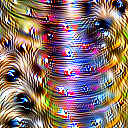

In [25]:
_ = render.render_vis(alexnet, 'features_11:9', show_inline=True) # show_inline=True despliega la imagen encontrada

También podemos visualizar una imagen representante de alguna de las clases. Para ello usamos el formato `labels:índice_de_la_clase`

100%|██████████| 512/512 [00:05<00:00, 94.71it/s]



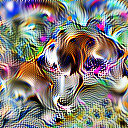

In [9]:
_ = render.render_vis(alexnet, 'labels:162', show_inline=True) # show_inline=True despliega la imagen encontrada

Ahora contamos con todas las herramientas necesarias para verificar que las redes convolucionales profundas aprenden de una manera jerárquica composicional. Veamos imágenes de cada una de las capas de AlexNet

100%|██████████| 512/512 [00:04<00:00, 109.49it/s]



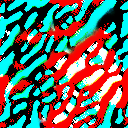

100%|██████████| 512/512 [00:04<00:00, 107.45it/s]



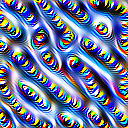

100%|██████████| 512/512 [00:04<00:00, 103.10it/s]



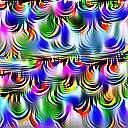

100%|██████████| 512/512 [00:05<00:00, 100.38it/s]



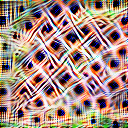

100%|██████████| 512/512 [00:05<00:00, 97.02it/s]



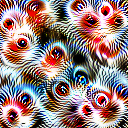

In [10]:
layers = ['features_1', 'features_4', 'features_7', 'features_9', 'features_11']
for layer in layers:
    render.render_vis(alexnet, f'{layer}:0', show_inline=True)

Podemos apreciar que los *features* evolucionan desde simple patrones de color a lo que parece ser un ojo de perro y pelaje.

#### Channel visualization
Veamos cómo son los features del resto de las arquitecturas. Visualizaremos 9 canales de la primera capa, una capa intermedia y la última capa convolucional de cada arquitectura

In [26]:
layers = {
    alexnet: ['features_1', 'features_7', 'features_11'],
    vgg19: ['features_1', 'features_17', 'features_35'],
    googlenet: ['conv1', 'inception4b', 'inception5b'],
    resnet50: ['relu', 'layer2', 'layer4']
}

In [27]:
import matplotlib.pyplot as plt # librería para desplegar gráficos

In [66]:
# función auxiliar para graficar una grilla de visualizaciones
def get_images(model, layers, rows, cols, preprocess=True, transforms=None):
    fig = plt.figure(figsize=(4*len(layers)*cols, 4*rows))
    outer_grid = fig.add_gridspec(1, len(layers))

    for layer_index, layer in enumerate(layers):
      inner_grid = outer_grid[0, layer_index].subgridspec(rows, cols, wspace=0, hspace=0)
      axs = inner_grid.subplots()
      for i in range(rows):
          for j in range(cols):
              image = render.render_vis(model, f'{layer}:{i*cols+j}', preprocess=preprocess, transforms=transforms, show_inline=True)[0][0] # Acá estamos calculando la imagen de la capa y canal correspondiente
              ax = axs[i][j]
              ax.imshow(image)
              if i==(rows-1) and j==cols//2:
                ax.set_xlabel(layer, fontsize=18)
              ax.set(xticks=[], yticks=[])

    plt.show()

100%|██████████| 512/512 [00:04<00:00, 108.99it/s]



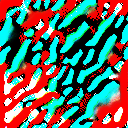

100%|██████████| 512/512 [00:03<00:00, 140.01it/s]



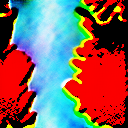

100%|██████████| 512/512 [00:03<00:00, 146.75it/s]



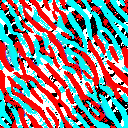

100%|██████████| 512/512 [00:03<00:00, 147.33it/s]



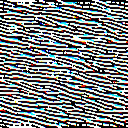

100%|██████████| 512/512 [00:03<00:00, 146.86it/s]



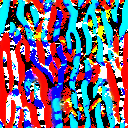

100%|██████████| 512/512 [00:03<00:00, 148.54it/s]



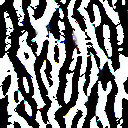

100%|██████████| 512/512 [00:03<00:00, 150.26it/s]



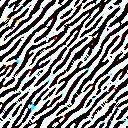

100%|██████████| 512/512 [00:03<00:00, 150.74it/s]



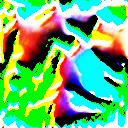

100%|██████████| 512/512 [00:03<00:00, 150.53it/s]



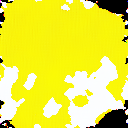

100%|██████████| 512/512 [00:03<00:00, 139.28it/s]



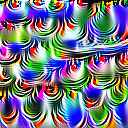

100%|██████████| 512/512 [00:03<00:00, 138.86it/s]



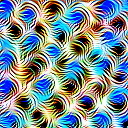

100%|██████████| 512/512 [00:03<00:00, 137.41it/s]



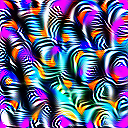

100%|██████████| 512/512 [00:03<00:00, 139.63it/s]



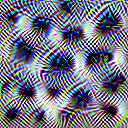

100%|██████████| 512/512 [00:03<00:00, 138.25it/s]



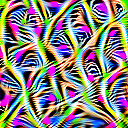

100%|██████████| 512/512 [00:03<00:00, 137.88it/s]



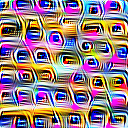

100%|██████████| 512/512 [00:03<00:00, 138.77it/s]



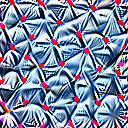

100%|██████████| 512/512 [00:03<00:00, 138.40it/s]



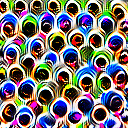

100%|██████████| 512/512 [00:03<00:00, 138.52it/s]



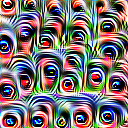

100%|██████████| 512/512 [00:03<00:00, 130.98it/s]



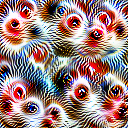

100%|██████████| 512/512 [00:03<00:00, 130.38it/s]



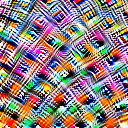

100%|██████████| 512/512 [00:03<00:00, 130.45it/s]



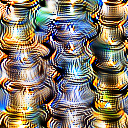

100%|██████████| 512/512 [00:03<00:00, 130.34it/s]



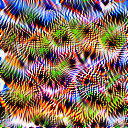

100%|██████████| 512/512 [00:03<00:00, 129.98it/s]



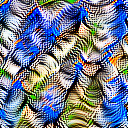

100%|██████████| 512/512 [00:03<00:00, 129.97it/s]



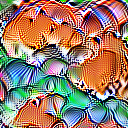

100%|██████████| 512/512 [00:03<00:00, 130.02it/s]



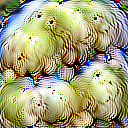

100%|██████████| 512/512 [00:03<00:00, 129.67it/s]



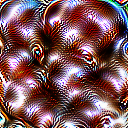

100%|██████████| 512/512 [00:03<00:00, 129.15it/s]



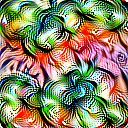

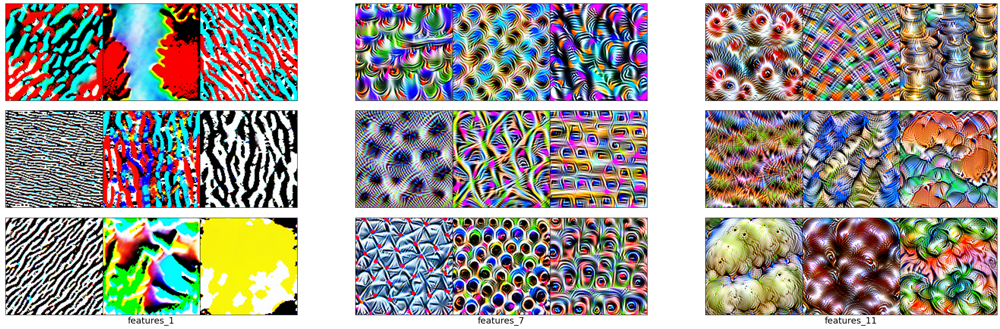

In [14]:
get_images(alexnet, layers[alexnet], 3, 3)

100%|██████████| 512/512 [00:04<00:00, 117.47it/s]



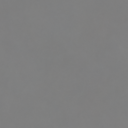

100%|██████████| 512/512 [00:04<00:00, 117.32it/s]



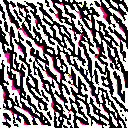

100%|██████████| 512/512 [00:04<00:00, 117.28it/s]



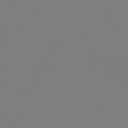

100%|██████████| 512/512 [00:04<00:00, 116.11it/s]



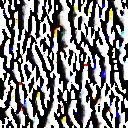

100%|██████████| 512/512 [00:04<00:00, 117.09it/s]



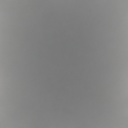

100%|██████████| 512/512 [00:04<00:00, 112.46it/s]



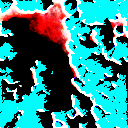

100%|██████████| 512/512 [00:04<00:00, 112.20it/s]



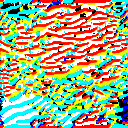

100%|██████████| 512/512 [00:04<00:00, 113.09it/s]



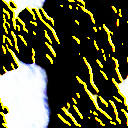

100%|██████████| 512/512 [00:04<00:00, 112.80it/s]



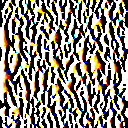

100%|██████████| 512/512 [00:05<00:00, 90.00it/s]



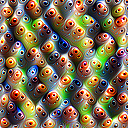

100%|██████████| 512/512 [00:05<00:00, 89.56it/s]



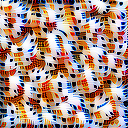

100%|██████████| 512/512 [00:05<00:00, 87.67it/s]



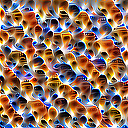

100%|██████████| 512/512 [00:05<00:00, 89.59it/s]



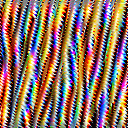

100%|██████████| 512/512 [00:05<00:00, 89.59it/s]



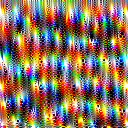

100%|██████████| 512/512 [00:05<00:00, 89.59it/s]



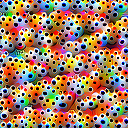

100%|██████████| 512/512 [00:06<00:00, 79.18it/s]



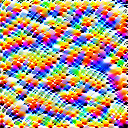

100%|██████████| 512/512 [00:07<00:00, 72.47it/s]



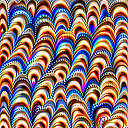

100%|██████████| 512/512 [00:07<00:00, 72.49it/s]



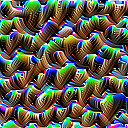

100%|██████████| 512/512 [00:08<00:00, 62.04it/s]



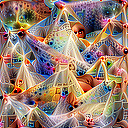

100%|██████████| 512/512 [00:08<00:00, 62.34it/s]



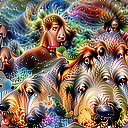

100%|██████████| 512/512 [00:08<00:00, 62.36it/s]



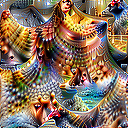

100%|██████████| 512/512 [00:08<00:00, 62.20it/s]



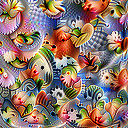

100%|██████████| 512/512 [00:08<00:00, 63.45it/s]



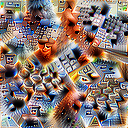

100%|██████████| 512/512 [00:08<00:00, 62.26it/s]



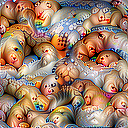

100%|██████████| 512/512 [00:08<00:00, 58.35it/s]



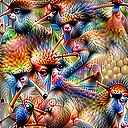

100%|██████████| 512/512 [00:07<00:00, 64.72it/s]



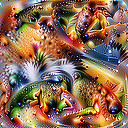

100%|██████████| 512/512 [00:07<00:00, 64.46it/s]



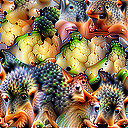

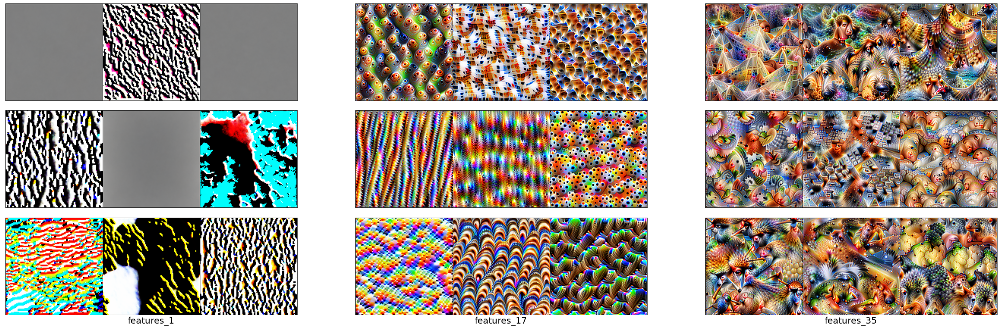

In [15]:
get_images(vgg19, layers[vgg19], 3, 3)

100%|██████████| 512/512 [00:11<00:00, 44.76it/s]



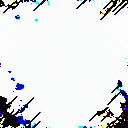

100%|██████████| 512/512 [00:11<00:00, 44.16it/s]



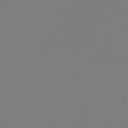

100%|██████████| 512/512 [00:11<00:00, 44.42it/s]



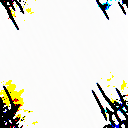

100%|██████████| 512/512 [00:11<00:00, 43.85it/s]



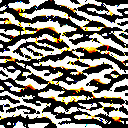

100%|██████████| 512/512 [00:11<00:00, 43.83it/s]



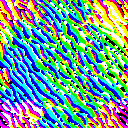

100%|██████████| 512/512 [00:11<00:00, 43.62it/s]



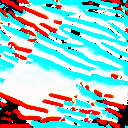

100%|██████████| 512/512 [00:11<00:00, 43.73it/s]



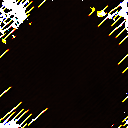

100%|██████████| 512/512 [00:11<00:00, 43.58it/s]



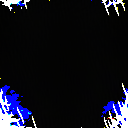

100%|██████████| 512/512 [00:11<00:00, 43.75it/s]



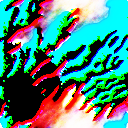

100%|██████████| 512/512 [00:15<00:00, 32.70it/s]



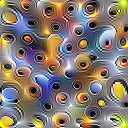

100%|██████████| 512/512 [00:15<00:00, 32.60it/s]



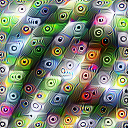

100%|██████████| 512/512 [00:15<00:00, 32.45it/s]



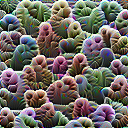

100%|██████████| 512/512 [00:17<00:00, 30.00it/s]



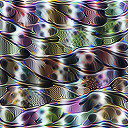

100%|██████████| 512/512 [00:16<00:00, 30.32it/s]



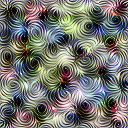

100%|██████████| 512/512 [00:17<00:00, 29.86it/s]



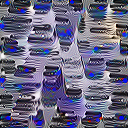

100%|██████████| 512/512 [00:17<00:00, 29.29it/s]



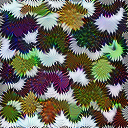

100%|██████████| 512/512 [00:17<00:00, 29.05it/s]



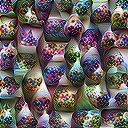

100%|██████████| 512/512 [00:17<00:00, 28.75it/s]



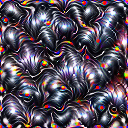

100%|██████████| 512/512 [00:21<00:00, 23.32it/s]



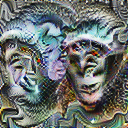

100%|██████████| 512/512 [00:21<00:00, 23.33it/s]



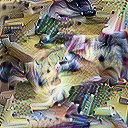

100%|██████████| 512/512 [00:22<00:00, 22.48it/s]



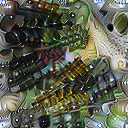

100%|██████████| 512/512 [00:22<00:00, 22.78it/s]



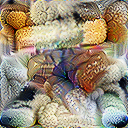

100%|██████████| 512/512 [00:22<00:00, 22.96it/s]



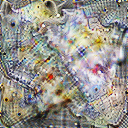

100%|██████████| 512/512 [00:22<00:00, 22.94it/s]



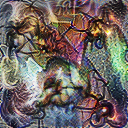

100%|██████████| 512/512 [00:22<00:00, 22.47it/s]



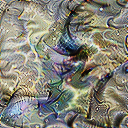

100%|██████████| 512/512 [00:22<00:00, 22.75it/s]



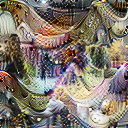

100%|██████████| 512/512 [00:22<00:00, 22.45it/s]



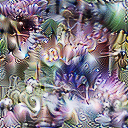

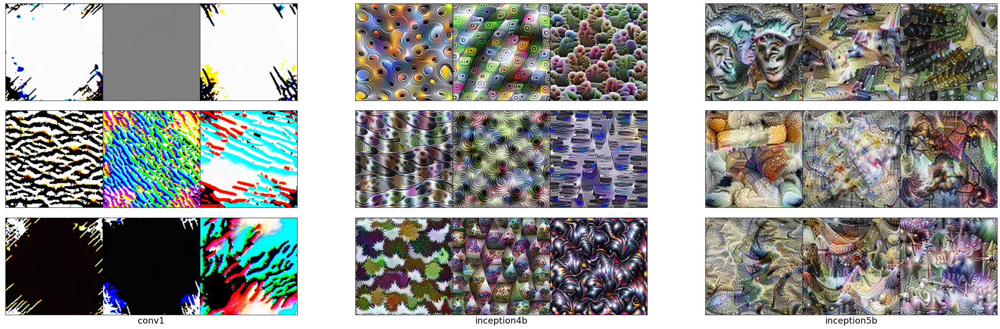

In [16]:
get_images(googlenet, layers[googlenet], 3, 3)

100%|██████████| 512/512 [00:10<00:00, 46.77it/s]



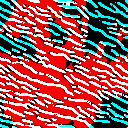

100%|██████████| 512/512 [00:10<00:00, 46.59it/s]



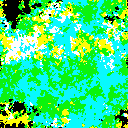

100%|██████████| 512/512 [00:11<00:00, 46.28it/s]



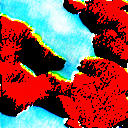

100%|██████████| 512/512 [00:10<00:00, 46.61it/s]



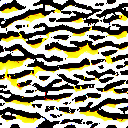

100%|██████████| 512/512 [00:11<00:00, 45.21it/s]



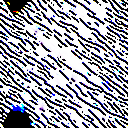

100%|██████████| 512/512 [00:11<00:00, 46.14it/s]



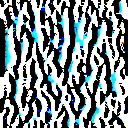

100%|██████████| 512/512 [00:11<00:00, 45.64it/s]



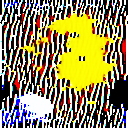

100%|██████████| 512/512 [00:11<00:00, 46.23it/s]



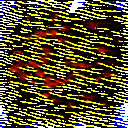

100%|██████████| 512/512 [00:10<00:00, 46.91it/s]



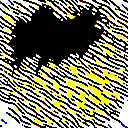

100%|██████████| 512/512 [00:14<00:00, 35.28it/s]



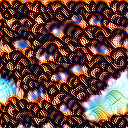

100%|██████████| 512/512 [00:14<00:00, 35.30it/s]



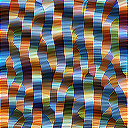

100%|██████████| 512/512 [00:14<00:00, 35.38it/s]



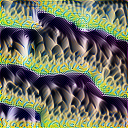

100%|██████████| 512/512 [00:14<00:00, 34.90it/s]



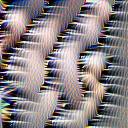

100%|██████████| 512/512 [00:14<00:00, 34.85it/s]



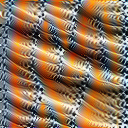

100%|██████████| 512/512 [00:14<00:00, 34.37it/s]



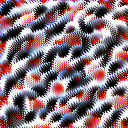

100%|██████████| 512/512 [00:14<00:00, 34.74it/s]



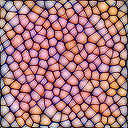

100%|██████████| 512/512 [00:14<00:00, 34.58it/s]



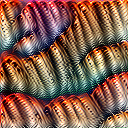

100%|██████████| 512/512 [00:15<00:00, 33.74it/s]



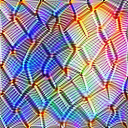

100%|██████████| 512/512 [00:19<00:00, 26.70it/s]



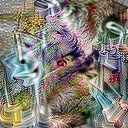

100%|██████████| 512/512 [00:19<00:00, 26.67it/s]



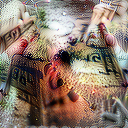

100%|██████████| 512/512 [00:19<00:00, 26.86it/s]



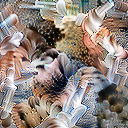

100%|██████████| 512/512 [00:19<00:00, 26.42it/s]



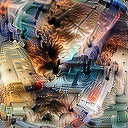

100%|██████████| 512/512 [00:19<00:00, 26.82it/s]



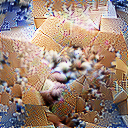

100%|██████████| 512/512 [00:18<00:00, 27.09it/s]



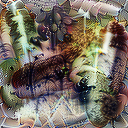

100%|██████████| 512/512 [00:19<00:00, 26.86it/s]



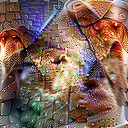

100%|██████████| 512/512 [00:18<00:00, 26.97it/s]



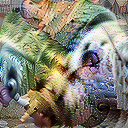

100%|██████████| 512/512 [00:19<00:00, 26.85it/s]



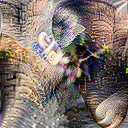

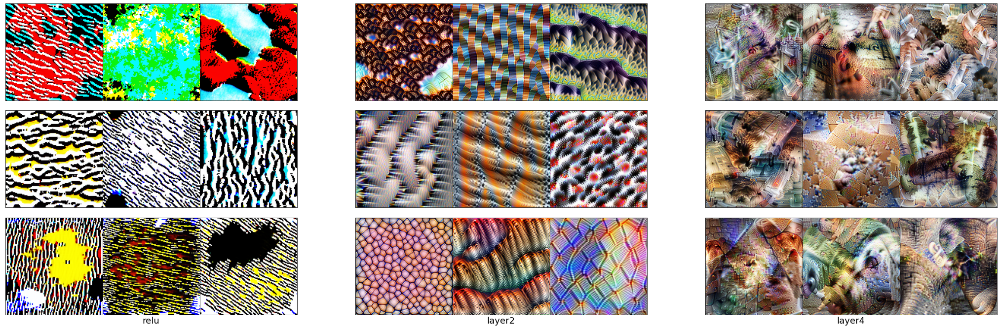

In [17]:
get_images(resnet50, layers[resnet50], 3, 3)

Podemos apreciar que la primera capa aprende features bastante similares para todas las aquitecturas, en cambio la última capa varía de arquitectura en arquitectura. La última capa convolucional de AlexNet, la menos profunda de todas las redes visualizadas, aprende features mucho menos complejos que el resto de las redes en sus capas finales.

#### Label visualization
Comparemos la representación de una de las clases en las distintas arquitecturas. Recordemos que para ello podemos usar como parámetro el string `labels:clase`.

En el siguiente [link](https://gist.githubusercontent.com/yrevar/942d3a0ac09ec9e5eb3a/raw/238f720ff059c1f82f368259d1ca4ffa5dd8f9f5/imagenet1000_clsidx_to_labels.txt) pueden ver a qué corresponde cada clase de ImageNet.

Visualizemos la clase 8, que corresponde a una gallina *(hen)*

100%|██████████| 512/512 [00:05<00:00, 96.64it/s]



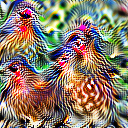

100%|██████████| 512/512 [00:19<00:00, 26.44it/s]



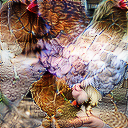

100%|██████████| 512/512 [00:09<00:00, 54.41it/s]



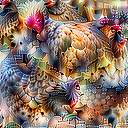

100%|██████████| 512/512 [00:21<00:00, 23.75it/s]



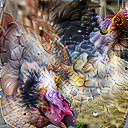

In [18]:
_ = render.render_vis(alexnet, 'labels:8', show_inline=True)
_ = render.render_vis(resnet50, 'labels:8', show_inline=True)
_ = render.render_vis(vgg19, 'labels:8', show_inline=True)
_ = render.render_vis(googlenet, 'labels:8', show_inline=True)

Claramente se pueden distinguir razgos muy característicos asociados a las gallinas en las 4 arquitecturas. Podemos concluir que todas las arquitecturas aprendieron a reconocer las gallinas efectivamente por su aspecto visual.

#### Diversidad
Veamos ahora algunas funcionalidades más avanzada de la librería. Como discutimos en clases un cocepto puede estar codificado en más de una neurona/capa y una neurona/capa puede representar más de un concepto al mismo tiempo.

Podemos agregar a la optimización de `lucent` un termino de diversidad. De esta manera podemos intentar ver los distintos conceptos representados para la neurona/capa.

Probemos el caso del canal 6 de la última capa convolucional de VGG19.

100%|██████████| 512/512 [01:51<00:00,  4.58it/s]



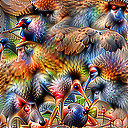
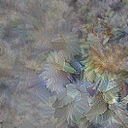
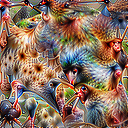
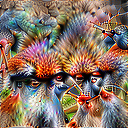
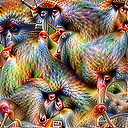
...
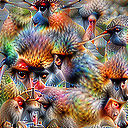
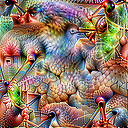
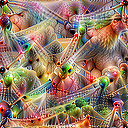
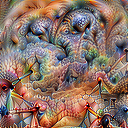
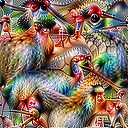

In [28]:
batch_param_f = lambda: param.image(128, batch=20) # optimizaremos 20 imágenes de tamaño 128x128
obj = objectives.channel('features_35', 6) - objectives.diversity('features_35') # el objetivo será visualizar los features del canal 6 de la capa features_35 considerando diversidad de la misma capa
_ = render.render_vis(vgg19, obj, param_f=batch_param_f, show_inline=True)

El objetivo de diversidad nos permitió ver que el canal analizado reacciona frente a la cara de un tipo de mono, un ave y un insecto (esto no significa que ese canal responde **solo** a esas clases).

### Flower Dataset

`lucent` funciona con los modelos importables de `pytorch`, pero también podemos utilizarla sobre modelos entrenados por nosotros mismos. Analicemos la representación de las distintas capas de nuestra implementación de AlexNet aplicada sobre el dataset de flores de los laboratorios anteriores.

In [ ]:
!wget https://www.dropbox.com/s/jxk9m5d2umscr1a/lab1_CNN_IA.zip
!unzip lab1_CNN_IA.zip
!tar -xzf flowers.tar.gz

--2020-11-10 00:13:04--  https://www.dropbox.com/s/jxk9m5d2umscr1a/lab1_CNN_IA.zip
Resolving www.dropbox.com (www.dropbox.com)... 162.125.4.1, 2620:100:6019:1::a27d:401
Connecting to www.dropbox.com (www.dropbox.com)|162.125.4.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/jxk9m5d2umscr1a/lab1_CNN_IA.zip [following]
--2020-11-10 00:13:04--  https://www.dropbox.com/s/raw/jxk9m5d2umscr1a/lab1_CNN_IA.zip
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc985f329538da036a7bdc91a10d.dl.dropboxusercontent.com/cd/0/inline/BC4xYTFCcd0ZEhg_jeYR787Sbd3qjhW12ubkHctviOKCrfz1uxOaRxHCZpRkUi_nMd-q2oC_UjFJOCmRojYzkGM8GnR1c8bPoEBxIkIzx8g331LkmAydJSfTZItUfUesJWI/file# [following]
--2020-11-10 00:13:04--  https://uc985f329538da036a7bdc91a10d.dl.dropboxusercontent.com/cd/0/inline/BC4xYTFCcd0ZEhg_jeYR787Sbd3qjhW12ubkHctviOKCrfz1uxOaRxHCZpRkUi_nMd-q2oC_UjFJOCmRojYzkGM8GnR1c8bPoEBxIkIzx

In [29]:
import torch
import torch.nn as nn           # Esto es PyTorch y su módulo de Redes Neuronales

class MiAlexNet(nn.Module):               # Esta clase representa nuestro modelo

    def __init__(self):   # Constructor, aquí armamos las piezas de nuestra red
        super(MiAlexNet, self).__init__()
        # Bloques Convolucionales
        # Recordemos que los Bloques Convolucionales van a estar hechos de 3
        # elementos: Convolución, Pooling y Activación.
        # En este caso usaremos Convoluciones 2d, Max Pooling y ReLU

        # Input = 3x 224 x 224 Output = 96 x 55 x 55 --> Max Pool = 96 x 27 x 27
        self.conv1 = nn.Sequential(
            nn.Conv2d(                           # Todo esto define a la Convolución
                      in_channels=3,             # Filtros/Canales de Entrada (RGB)
                      out_channels=96,           # Filtros/Canales de Salida
                      kernel_size=(11,11),       # Tamaño de la Convolución
                      stride=(4,4),              # Stride
                      padding=2),                # Cuántos pixeles de padding
            nn.MaxPool2d(kernel_size=(3,3), stride=(2,2)), # Max Pooling
            nn.ReLU()                            # Activación                            
        )

        # Input = 96 x 27 x 27 Output = 256 x 27 x 27 --> Max Pool = 256 x 13 x 13
        self.conv2 = nn.Sequential(
            nn.Conv2d(                          
                      in_channels=96,            
                      out_channels=256,         
                      kernel_size=(5,5),         
                      stride=(1,1),              
                      padding=2),               
            nn.MaxPool2d(kernel_size=(3,3), stride=(2,2)),
            nn.ReLU()                                                 
        )
        # Input = 256 x 13 x 13 Output = 384 x 13 x 13
        self.conv3 = nn.Sequential(
            nn.Conv2d(                           
                      in_channels=256,          
                      out_channels=384,         
                      kernel_size=(3,3),         
                      stride=(1,1),              
                      padding=1),                
            nn.ReLU()                                                     
        )
        # Input = 384 x 13 x 13 Output = 384 x 13 x 13
        self.conv4 = nn.Sequential(
            nn.Conv2d(                           
                      in_channels=384,           
                      out_channels=384,         
                      kernel_size=(3,3),         
                      stride=(1,1),              
                      padding=1),                
            nn.ReLU()                                            
        )
        # Input = 384 x 13 x 13 Output = 256 x 13 x 13 --> MaxPool = 256 x 6 x 6
        self.conv5 = nn.Sequential(
            nn.Conv2d(                          
                      in_channels=384,           
                      out_channels=256,       
                      kernel_size=(3,3),         
                      stride=(1,1),          
                      padding=1),               
            nn.MaxPool2d(kernel_size=(3,3), stride=(2,2)),
            nn.ReLU()                                               
        )
        ##
        self.flat = nn.Flatten()    # Capa aplanamiento para poder vincular
                                    # resultado convolucional con capas
                                    # lineales.
        # Bloques Fully Connected/MLP
        # Input = 256 x 6 x 6 = 9216 Output = 4096
        self.fc6 = nn.Sequential(
                                  nn.Linear(9216, 4096), 
                                  nn.ReLU()
                                  )
        # Input = 4096 Output = 4096
        self.fc7 = nn.Sequential(
                                  nn.Linear(4096, 4096), 
                                  nn.ReLU()
                                  )
        # Input = 4096 Output = 1000
        self.fc8 = nn.Sequential(
                                  nn.Linear(4096, 102)
                                  )

    def forward(self, x):        # Aquí armamos cómo se conectan las piezas
                                 # Esta red es sencilla pues solo tenemos
                                 # que conectar las piezas una detrás de la
                                 # otra. No todas las redes son así.                      
        x = self.conv1(x)
        x = self.conv2(x)   
        x = self.conv3(x) 
        x = self.conv4(x)
        x = self.conv5(x)
        x = self.flat(x) 
        x = self.fc6(x) 
        x = self.fc7(x)
        x = self.fc8(x)

        return x

Cargamos los pesos del modelo entrenado en el dataset con anterioridad

In [ ]:
!wget https://www.dropbox.com/s/y2b5a8rql90kd2c/base_alexnet.pth

--2020-11-10 00:13:46--  https://www.dropbox.com/s/y2b5a8rql90kd2c/base_alexnet.pth
Resolving www.dropbox.com (www.dropbox.com)... 162.125.4.1, 2620:100:6019:1::a27d:401
Connecting to www.dropbox.com (www.dropbox.com)|162.125.4.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/y2b5a8rql90kd2c/base_alexnet.pth [following]
--2020-11-10 00:13:46--  https://www.dropbox.com/s/raw/y2b5a8rql90kd2c/base_alexnet.pth
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc8c085e58453a28df4149027b4f.dl.dropboxusercontent.com/cd/0/inline/BC7JBeKJx6T2aC9dxBs8YyhhJg3mmVYlJlGhpuyCI7IEm9cO7GDJR9JHSDXQtVUmYsy6QKZIQq1MbvaCkKz1PaSguJsnAjgEvyM1PNt-LBBlGzsQExYpAmk6s7pzjxkUe38/file# [following]
--2020-11-10 00:13:47--  https://uc8c085e58453a28df4149027b4f.dl.dropboxusercontent.com/cd/0/inline/BC7JBeKJx6T2aC9dxBs8YyhhJg3mmVYlJlGhpuyCI7IEm9cO7GDJR9JHSDXQtVUmYsy6QKZIQq1MbvaCkKz1PaSguJsnAjgEvyM1PN

In [30]:
base_alexnet = MiAlexNet()
weights = torch.load("base_alexnet.pth")
base_alexnet.load_state_dict(weights)
base_alexnet.to(device)
_ = base_alexnet.eval() # es importante poner el modelo en modo eval, de lo contrario capas como batch normalization o dropout interferirán

In [31]:
from test_model import test_model # función para evaluar el rendimiento de un modelo en un dataset
from torch.utils.data import DataLoader

In [1]:
from os import listdir
from os.path import join

from PIL import Image
import torch
from torchvision.transforms import Compose, ToTensor, Resize, Normalize


class Flowers(torch.utils.data.Dataset):
    def __init__(self, root, transform=None):
        self.root = root
        self.transform = transform
        self.imagenes = []       # Vincula el indice con un nombre de archivo
        self.imgs_to_class = []  # Vincula el indice con una clase
        self.imagenes, self.imgs_to_class = self.armar_indices(root)

    def armar_indices(self, root):
        # El número de carpetas es la cantidad de clases
        n_classes = len(listdir(root))
        contador = 0
        lista_imagenes = []
        imgs_to_class = []

        for clase in sorted(listdir(root)):
            directorio = join(root, clase)
            for archivo in sorted(listdir(directorio)):
                lista_imagenes.append(archivo)
                contador += 1
                imgs_to_class.append(int(clase))

        return lista_imagenes, imgs_to_class

    def obtener_imagen(self, archivo):
        return Image.open(archivo)

    def __getitem__(self, idx):
        nombre_archivo = self.imagenes[idx]
        clase = self.imgs_to_class[idx]
        ruta_img = join(self.root, str(clase))
        ruta_img = join(ruta_img, nombre_archivo)
        img = self.obtener_imagen(ruta_img)

        if self.transform is not None:
            img = self.transform(img)

        return img, clase

    def __len__(self):
        return len(self.imagenes)


In [33]:
transforms = Compose([Resize((224,224)), ToTensor()])

ds_train = Flowers("flowers_dataset/train", transform=transforms)
train_dl = DataLoader(ds_train, batch_size=256)

ds_test = Flowers("flowers_dataset/test", transform=transforms)
test_dl = DataLoader(ds_test, batch_size=256)

In [34]:
test_model(base_alexnet, train_dl)

Correctas: 4542.0 Total: 5687.0 Accuracy: 79.87%

In [ ]:
test_model(base_alexnet, train_dl)

Correctas: 4542.0 Total: 5687.0 Accuracy: 79.87%

In [35]:
test_model(base_alexnet, test_dl)

Correctas: 1404.0 Total: 1738.0 Accuracy: 80.78%

Estos pesos obtienen un 98.17% de accuracy en el set de train y un 80.2% en el set de test. Esta diferencia de rendimiento entre los sets recibe el nombre de **overfitting**, es decir, el modelo se está sobreajustando a los datos de entrenamiento y por lo tanto lo hace muy bien en ese set, pero al momento de ser evaluado en datos que no ha visto su rendimiento es mucho más bajo.

In [30]:
get_model_layers(base_alexnet)

['conv1',
 'conv1_0',
 'conv1_1',
 'conv1_2',
 'conv2',
 'conv2_0',
 'conv2_1',
 'conv2_2',
 'conv3',
 'conv3_0',
 'conv3_1',
 'conv4',
 'conv4_0',
 'conv4_1',
 'conv5',
 'conv5_0',
 'conv5_1',
 'conv5_2',
 'flat',
 'fc6',
 'fc6_0',
 'fc6_1',
 'fc7',
 'fc7_0',
 'fc7_1',
 'fc8',
 'fc8_0']

Una buena práctica antes de hacer pasar los datos por una red neuronal, es restarles la media y dividirlos por la desviación estándar del dataset. `lucent` asume que el modelo de input se entrenó con ImageNet, así que normaliza los datos con los valores para ese dataset. En nuestro caso, los datos no fueron normalizados, así que debemos informarle a la librería que no aplique ningún preprocesamiento. Para ello utilizamos el parámetro `preprocess=False` (por default es `True`).

Veamos las mismas capas que revisamos para el modelo entrenado en ImageNet, además de las 9 primeras clases de flores.

100%|██████████| 512/512 [00:04<00:00, 121.46it/s]



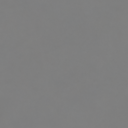

100%|██████████| 512/512 [00:04<00:00, 118.59it/s]



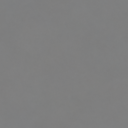

100%|██████████| 512/512 [00:04<00:00, 117.13it/s]



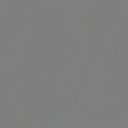

100%|██████████| 512/512 [00:04<00:00, 118.27it/s]



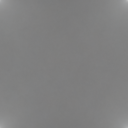

100%|██████████| 512/512 [00:04<00:00, 119.77it/s]



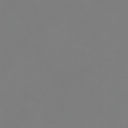

100%|██████████| 512/512 [00:04<00:00, 119.39it/s]



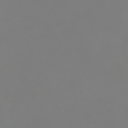

100%|██████████| 512/512 [00:04<00:00, 119.42it/s]



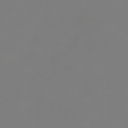

100%|██████████| 512/512 [00:04<00:00, 118.82it/s]



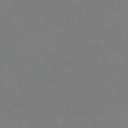

100%|██████████| 512/512 [00:04<00:00, 118.65it/s]



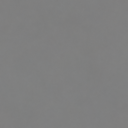

100%|██████████| 512/512 [00:04<00:00, 112.25it/s]



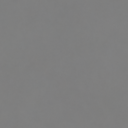

100%|██████████| 512/512 [00:04<00:00, 113.24it/s]



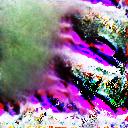

100%|██████████| 512/512 [00:04<00:00, 110.74it/s]



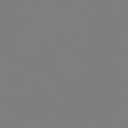

100%|██████████| 512/512 [00:04<00:00, 108.10it/s]



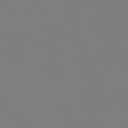

100%|██████████| 512/512 [00:04<00:00, 110.62it/s]



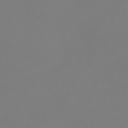

100%|██████████| 512/512 [00:04<00:00, 113.45it/s]



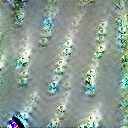

100%|██████████| 512/512 [00:04<00:00, 113.55it/s]



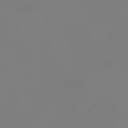

100%|██████████| 512/512 [00:04<00:00, 110.87it/s]



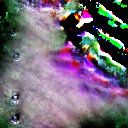

100%|██████████| 512/512 [00:04<00:00, 110.26it/s]



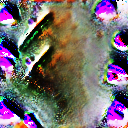

100%|██████████| 512/512 [00:04<00:00, 104.86it/s]



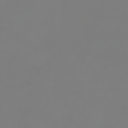

100%|██████████| 512/512 [00:04<00:00, 105.57it/s]



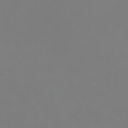

100%|██████████| 512/512 [00:04<00:00, 104.81it/s]



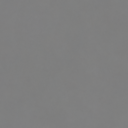

100%|██████████| 512/512 [00:04<00:00, 105.04it/s]



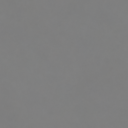

100%|██████████| 512/512 [00:04<00:00, 104.88it/s]



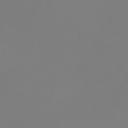

100%|██████████| 512/512 [00:04<00:00, 105.11it/s]



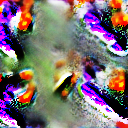

100%|██████████| 512/512 [00:04<00:00, 105.50it/s]



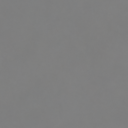

100%|██████████| 512/512 [00:04<00:00, 120.71it/s]



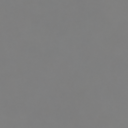

100%|██████████| 512/512 [00:03<00:00, 135.09it/s]



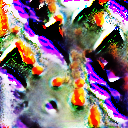

100%|██████████| 512/512 [00:04<00:00, 125.13it/s]



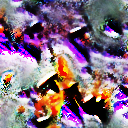

100%|██████████| 512/512 [00:04<00:00, 125.54it/s]



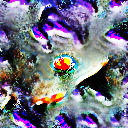

100%|██████████| 512/512 [00:04<00:00, 126.45it/s]



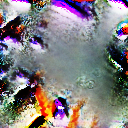

100%|██████████| 512/512 [00:04<00:00, 124.75it/s]



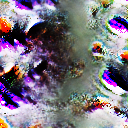

100%|██████████| 512/512 [00:04<00:00, 118.13it/s]



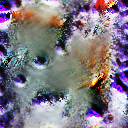

100%|██████████| 512/512 [00:04<00:00, 124.60it/s]



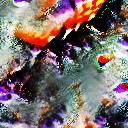

100%|██████████| 512/512 [00:04<00:00, 124.36it/s]



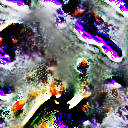

100%|██████████| 512/512 [00:04<00:00, 121.39it/s]



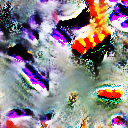

100%|██████████| 512/512 [00:04<00:00, 122.41it/s]



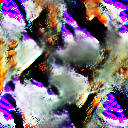

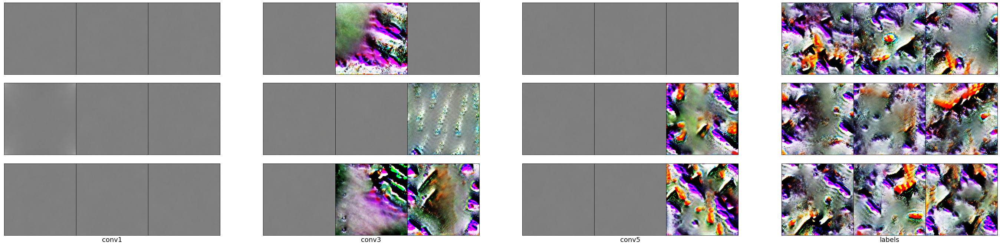

In [31]:
get_images(base_alexnet, ['conv1', 'conv3', 'conv5', 'labels'], 3, 3, preprocess=False)

Se aprecia una diferencia importante entre el modelo entrenado en ImageNet y el modelo entrado en el Flower Dataset.

En primer lugar, muchas de las imágenes son grises. Esto significa, que no fue posible encontrar una imagen que generara una alta activación en esos canales (una explicación posible es que tenemos más filtros de los necesarios, verificaremos esto más adelante).

Otro aspecto interesante es que las imágenes para las primera 9 clases no tienen una forma de flor definida. Una hipótesis es que el modelo está sufriendo overfitting, ya que la diferencia entre el set de entrenamiento y el de test es considerable, más de 15 puntos porcentuales, por lo que está memorizando aspectos específicos de los ejemplos de entrenamiento más que generalizando a una representación interna para cada flor que tenga que ver con la realidad.

#### Filtros extra

Veamos en detalle todos los filtros de la primera capa

100%|██████████| 512/512 [00:03<00:00, 149.50it/s]



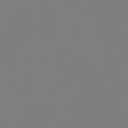

100%|██████████| 512/512 [00:03<00:00, 149.41it/s]



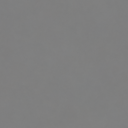

100%|██████████| 512/512 [00:03<00:00, 148.77it/s]



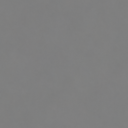

100%|██████████| 512/512 [00:03<00:00, 148.90it/s]



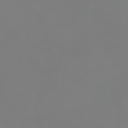

100%|██████████| 512/512 [00:03<00:00, 148.99it/s]



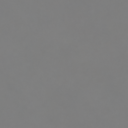

100%|██████████| 512/512 [00:03<00:00, 148.05it/s]



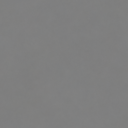

100%|██████████| 512/512 [00:03<00:00, 148.58it/s]



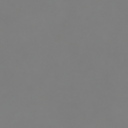

100%|██████████| 512/512 [00:03<00:00, 149.15it/s]



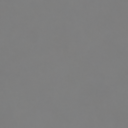

100%|██████████| 512/512 [00:03<00:00, 147.31it/s]



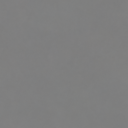

100%|██████████| 512/512 [00:03<00:00, 147.07it/s]



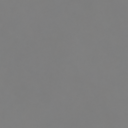

100%|██████████| 512/512 [00:03<00:00, 149.02it/s]



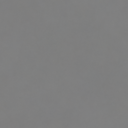

100%|██████████| 512/512 [00:03<00:00, 152.46it/s]



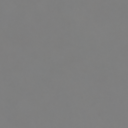

100%|██████████| 512/512 [00:03<00:00, 153.19it/s]



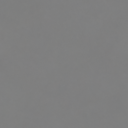

100%|██████████| 512/512 [00:03<00:00, 153.17it/s]



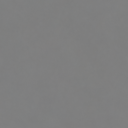

100%|██████████| 512/512 [00:03<00:00, 153.58it/s]



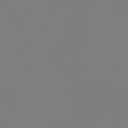

100%|██████████| 512/512 [00:03<00:00, 148.68it/s]



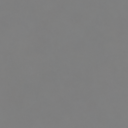

100%|██████████| 512/512 [00:03<00:00, 149.56it/s]



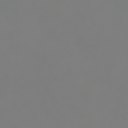

100%|██████████| 512/512 [00:03<00:00, 150.27it/s]



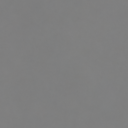

100%|██████████| 512/512 [00:03<00:00, 148.93it/s]



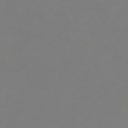

100%|██████████| 512/512 [00:03<00:00, 148.85it/s]



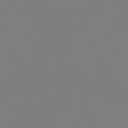

100%|██████████| 512/512 [00:03<00:00, 148.42it/s]



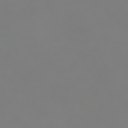

100%|██████████| 512/512 [00:03<00:00, 148.95it/s]



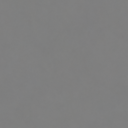

100%|██████████| 512/512 [00:03<00:00, 148.34it/s]



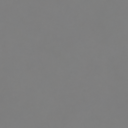

100%|██████████| 512/512 [00:03<00:00, 149.83it/s]



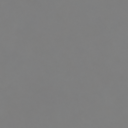

100%|██████████| 512/512 [00:03<00:00, 150.32it/s]



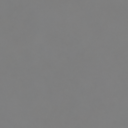

100%|██████████| 512/512 [00:03<00:00, 149.33it/s]



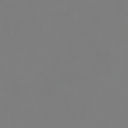

100%|██████████| 512/512 [00:03<00:00, 144.56it/s]



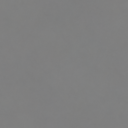

100%|██████████| 512/512 [00:03<00:00, 147.21it/s]



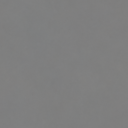

100%|██████████| 512/512 [00:03<00:00, 147.23it/s]



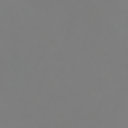

100%|██████████| 512/512 [00:03<00:00, 147.09it/s]



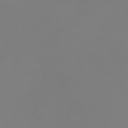

100%|██████████| 512/512 [00:03<00:00, 147.22it/s]



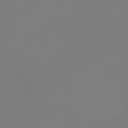

100%|██████████| 512/512 [00:03<00:00, 147.45it/s]



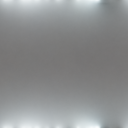

100%|██████████| 512/512 [00:03<00:00, 147.18it/s]



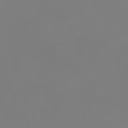

100%|██████████| 512/512 [00:03<00:00, 143.69it/s]



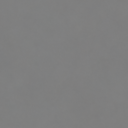

100%|██████████| 512/512 [00:03<00:00, 142.99it/s]



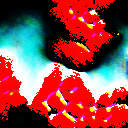

100%|██████████| 512/512 [00:03<00:00, 145.74it/s]



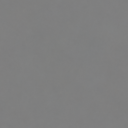

100%|██████████| 512/512 [00:03<00:00, 145.91it/s]



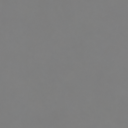

100%|██████████| 512/512 [00:03<00:00, 143.91it/s]



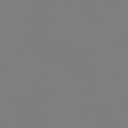

100%|██████████| 512/512 [00:03<00:00, 145.61it/s]



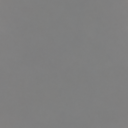

100%|██████████| 512/512 [00:03<00:00, 147.11it/s]



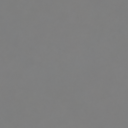

100%|██████████| 512/512 [00:03<00:00, 145.49it/s]



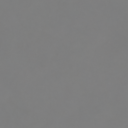

100%|██████████| 512/512 [00:03<00:00, 146.33it/s]



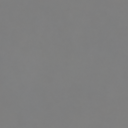

100%|██████████| 512/512 [00:03<00:00, 146.15it/s]



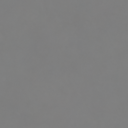

100%|██████████| 512/512 [00:03<00:00, 146.51it/s]



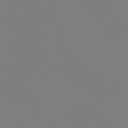

100%|██████████| 512/512 [00:03<00:00, 146.08it/s]



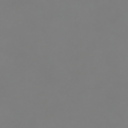

100%|██████████| 512/512 [00:03<00:00, 141.92it/s]



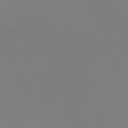

100%|██████████| 512/512 [00:03<00:00, 133.40it/s]



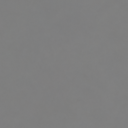

100%|██████████| 512/512 [00:03<00:00, 144.69it/s]



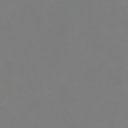

100%|██████████| 512/512 [00:03<00:00, 145.83it/s]



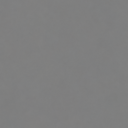

100%|██████████| 512/512 [00:03<00:00, 144.68it/s]



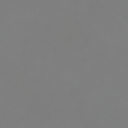

100%|██████████| 512/512 [00:03<00:00, 144.49it/s]



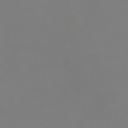

100%|██████████| 512/512 [00:03<00:00, 143.94it/s]



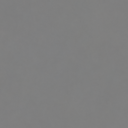

100%|██████████| 512/512 [00:03<00:00, 143.68it/s]



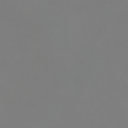

100%|██████████| 512/512 [00:03<00:00, 143.34it/s]



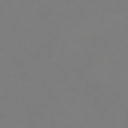

100%|██████████| 512/512 [00:03<00:00, 143.73it/s]



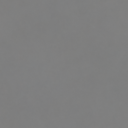

100%|██████████| 512/512 [00:03<00:00, 144.30it/s]



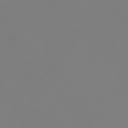

100%|██████████| 512/512 [00:03<00:00, 143.70it/s]



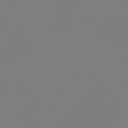

100%|██████████| 512/512 [00:03<00:00, 142.03it/s]



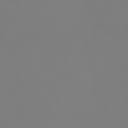

100%|██████████| 512/512 [00:03<00:00, 143.32it/s]



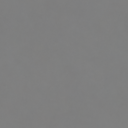

100%|██████████| 512/512 [00:03<00:00, 143.51it/s]



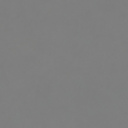

100%|██████████| 512/512 [00:03<00:00, 143.31it/s]



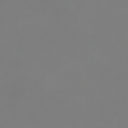

100%|██████████| 512/512 [00:03<00:00, 144.24it/s]



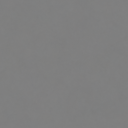

100%|██████████| 512/512 [00:03<00:00, 143.62it/s]



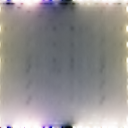

100%|██████████| 512/512 [00:03<00:00, 142.96it/s]



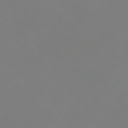

100%|██████████| 512/512 [00:03<00:00, 142.79it/s]



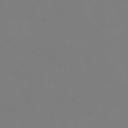

100%|██████████| 512/512 [00:03<00:00, 142.90it/s]



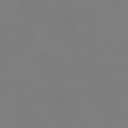

100%|██████████| 512/512 [00:03<00:00, 142.33it/s]



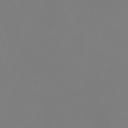

100%|██████████| 512/512 [00:03<00:00, 142.89it/s]



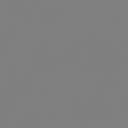

100%|██████████| 512/512 [00:03<00:00, 142.30it/s]



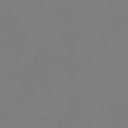

100%|██████████| 512/512 [00:03<00:00, 141.29it/s]



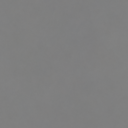

100%|██████████| 512/512 [00:03<00:00, 141.60it/s]



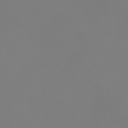

100%|██████████| 512/512 [00:03<00:00, 142.03it/s]



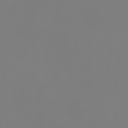

100%|██████████| 512/512 [00:04<00:00, 120.80it/s]



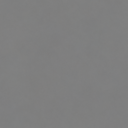

100%|██████████| 512/512 [00:04<00:00, 107.78it/s]



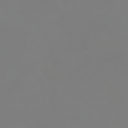

100%|██████████| 512/512 [00:04<00:00, 107.00it/s]



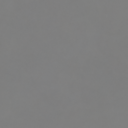

100%|██████████| 512/512 [00:04<00:00, 107.53it/s]



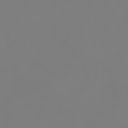

100%|██████████| 512/512 [00:04<00:00, 102.48it/s]



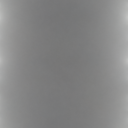

100%|██████████| 512/512 [00:04<00:00, 106.74it/s]



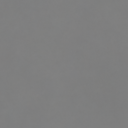

100%|██████████| 512/512 [00:04<00:00, 107.39it/s]



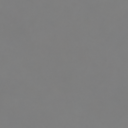

100%|██████████| 512/512 [00:04<00:00, 105.10it/s]



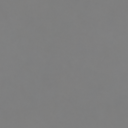

100%|██████████| 512/512 [00:04<00:00, 107.12it/s]



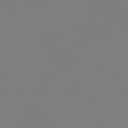

100%|██████████| 512/512 [00:04<00:00, 105.95it/s]



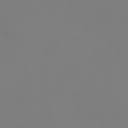

100%|██████████| 512/512 [00:04<00:00, 106.74it/s]



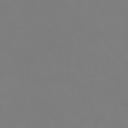

100%|██████████| 512/512 [00:04<00:00, 105.32it/s]



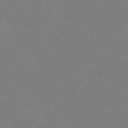

100%|██████████| 512/512 [00:04<00:00, 105.79it/s]



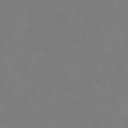

100%|██████████| 512/512 [00:04<00:00, 103.90it/s]



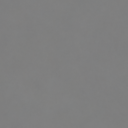

100%|██████████| 512/512 [00:04<00:00, 104.82it/s]



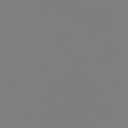

100%|██████████| 512/512 [00:05<00:00, 100.54it/s]



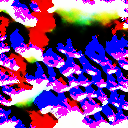

100%|██████████| 512/512 [00:04<00:00, 103.17it/s]



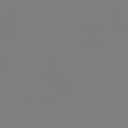

100%|██████████| 512/512 [00:04<00:00, 104.17it/s]



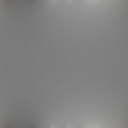

100%|██████████| 512/512 [00:05<00:00, 102.25it/s]



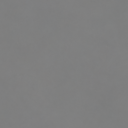

100%|██████████| 512/512 [00:04<00:00, 102.85it/s]



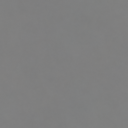

100%|██████████| 512/512 [00:05<00:00, 101.64it/s]



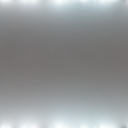

100%|██████████| 512/512 [00:05<00:00, 99.93it/s]



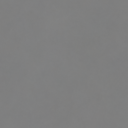

100%|██████████| 512/512 [00:04<00:00, 102.84it/s]



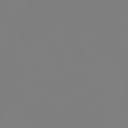

100%|██████████| 512/512 [00:04<00:00, 103.90it/s]



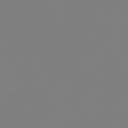

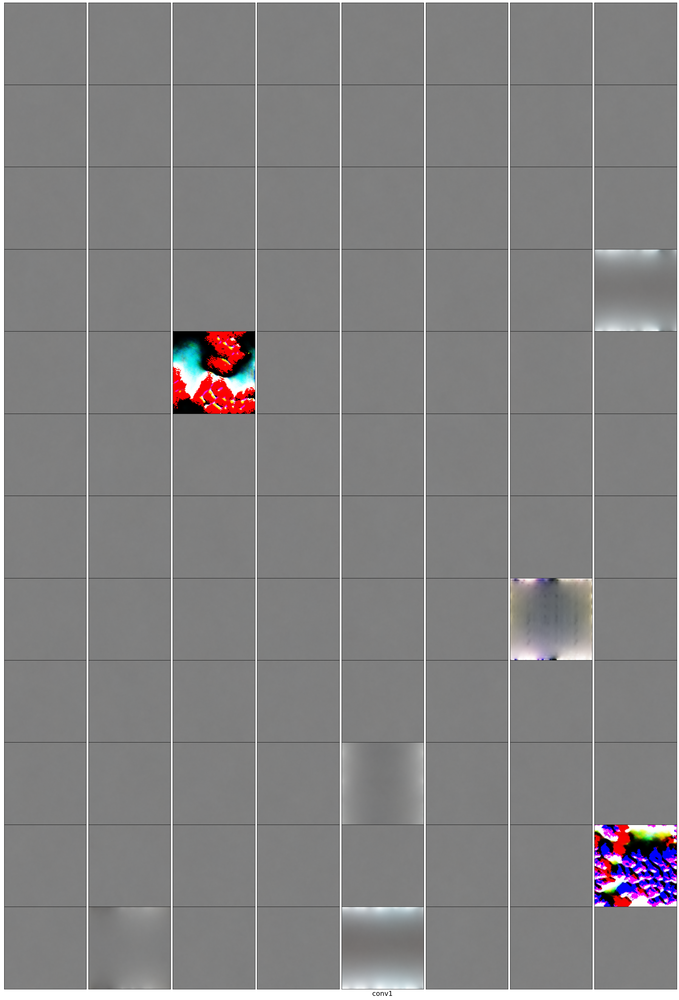

In [32]:
get_images(base_alexnet, ['conv1'], 12, 8, preprocess=False)

Solo para 7 de ellos hay una respuesta a simple vista. Probemos entrenando una versión de AlexNet con 12 filtros en vez de 96 para la primera capa. Si nuestra hipótesis es correcta, el rendimiento no debería verse muy afectado.

Para ello redefinimos nuestro modelo de Alexnet y cambiamos los `out_channels` de la primera convolución y los `in_channels` de la segunda convolución.

In [36]:
class MiAlexNet(nn.Module):               # Esta clase representa nuestro modelo

    def __init__(self):   # Constructor, aquí armamos las piezas de nuestra red
        super(MiAlexNet, self).__init__()
        # Bloques Convolucionales
        # Recordemos que los Bloques Convolucionales van a estar hechos de 3
        # elementos: Convolución, Pooling y Activación.
        # En este caso usaremos Convoluciones 2d, Max Pooling y ReLU

        # Input = 3x 224 x 224 Output = 96 x 55 x 55 --> Max Pool = 96 x 27 x 27
        self.conv1 = nn.Sequential(
            nn.Conv2d(                           # Todo esto define a la Convolución
                      in_channels=3,             # Filtros/Canales de Entrada (RGB)
                      out_channels=12,           # Filtros/Canales de Salida ACA HICIMOS EL CAMBIO
                      kernel_size=(11,11),       # Tamaño de la Convolución
                      stride=(4,4),              # Stride
                      padding=2),                # Cuántos pixeles de padding
            nn.MaxPool2d(kernel_size=(3,3), stride=(2,2)), # Max Pooling
            nn.ReLU()                            # Activación                            
        )

        # Input = 96 x 27 x 27 Output = 256 x 27 x 27 --> Max Pool = 256 x 13 x 13
        self.conv2 = nn.Sequential(
            nn.Conv2d(                          
                      in_channels=12,            # ACA HICIMOS EL CAMBIO
                      out_channels=256,         
                      kernel_size=(5,5),         
                      stride=(1,1),              
                      padding=2),               
            nn.MaxPool2d(kernel_size=(3,3), stride=(2,2)),
            nn.ReLU()                                                 
        )
        # Input = 256 x 13 x 13 Output = 384 x 13 x 13
        self.conv3 = nn.Sequential(
            nn.Conv2d(                           
                      in_channels=256,          
                      out_channels=384,         
                      kernel_size=(3,3),         
                      stride=(1,1),              
                      padding=1),                
            nn.ReLU()                                                     
        )
        # Input = 384 x 13 x 13 Output = 384 x 13 x 13
        self.conv4 = nn.Sequential(
            nn.Conv2d(                           
                      in_channels=384,           
                      out_channels=384,         
                      kernel_size=(3,3),         
                      stride=(1,1),              
                      padding=1),                
            nn.ReLU()                                            
        )
        # Input = 384 x 13 x 13 Output = 256 x 13 x 13 --> MaxPool = 256 x 6 x 6
        self.conv5 = nn.Sequential(
            nn.Conv2d(                          
                      in_channels=384,           
                      out_channels=256,       
                      kernel_size=(3,3),         
                      stride=(1,1),          
                      padding=1),               
            nn.MaxPool2d(kernel_size=(3,3), stride=(2,2)),
            nn.ReLU()                                               
        )
        ##
        self.flat = nn.Flatten()    # Capa aplanamiento para poder vincular
                                    # resultado convolucional con capas
                                    # lineales.
        # Bloques Fully Connected/MLP
        # Input = 256 x 6 x 6 = 9216 Output = 4096
        self.fc6 = nn.Sequential(
                                  nn.Linear(9216, 4096), 
                                  nn.ReLU()
                                  )
        # Input = 4096 Output = 4096
        self.fc7 = nn.Sequential(
                                  nn.Linear(4096, 4096), 
                                  nn.ReLU()
                                  )
        # Input = 4096 Output = 1000
        self.fc8 = nn.Sequential(
                                  nn.Linear(4096, 102)
                                  )

    def forward(self, x):        # Aquí armamos cómo se conectan las piezas
                                 # Esta red es sencilla pues solo tenemos
                                 # que conectar las piezas una detrás de la
                                 # otra. No todas las redes son así.                      
        x = self.conv1(x)
        x = self.conv2(x)   
        x = self.conv3(x) 
        x = self.conv4(x)
        x = self.conv5(x)
        x = self.flat(x) 
        x = self.fc6(x) 
        x = self.fc7(x)
        x = self.fc8(x)

        return x

Para acelerar el proceso descargamos pesos entrenados en esta nueva arquitectura de antemano

In [ ]:
!wget https://www.dropbox.com/s/qbzy22qqggrlcx7/alexnet_12_filters.pth

--2020-11-10 00:27:24--  https://www.dropbox.com/s/qbzy22qqggrlcx7/alexnet_12_filters.pth
Resolving www.dropbox.com (www.dropbox.com)... 162.125.7.1, 2620:100:6019:1::a27d:401
Connecting to www.dropbox.com (www.dropbox.com)|162.125.7.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/qbzy22qqggrlcx7/alexnet_12_filters.pth [following]
--2020-11-10 00:27:24--  https://www.dropbox.com/s/raw/qbzy22qqggrlcx7/alexnet_12_filters.pth
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc9222506967948f26ebf29fd8bf.dl.dropboxusercontent.com/cd/0/inline/BC7l6Dw1-AGWEwtEIe1Bj0c1jaiQg70QUFb9olzYoznb3-_aYfu-zNSqzjpql05ULJUb2DkvAdTd8iccfhWCG11p3PaVZrUUpkVpg8XVsqCen3-wln1FLuJxzxcbvSocLuI/file# [following]
--2020-11-10 00:27:25--  https://uc9222506967948f26ebf29fd8bf.dl.dropboxusercontent.com/cd/0/inline/BC7l6Dw1-AGWEwtEIe1Bj0c1jaiQg70QUFb9olzYoznb3-_aYfu-zNSqzjpql05ULJUb2DkvAdTd8iccfhWC

Creamos una instancia de la nueva arquitectura y cargamos los pesos que acabamos de descargar

In [37]:
alexnet_12_filters = MiAlexNet()
alexnet_12_filters.to(device)
weights = torch.load("alexnet_12_filters.pth")
alexnet_12_filters.load_state_dict(weights)
_ = alexnet_12_filters.eval() # es importante poner el modelo en modo eval, de lo contrario capas como batch normalization o dropout interferirán

Evaluamos en el set de train y test

In [38]:
test_model(alexnet_12_filters, train_dl)

Correctas: 4411.0 Total: 5687.0 Accuracy: 77.56%

In [39]:
test_model(alexnet_12_filters, test_dl)

Correctas: 1390.0 Total: 1738.0 Accuracy: 79.98%

Efectivamente, a pesar de que disminuimos la cantidad de filtros de la primera cada de 96 a 12, el rendimiento en el set de test solo bajó 1 punto porcentual, por lo que nuestra hipótesis de que teníamos filtros de más era acertada.

#### Overfitting

Uno de los motivos del overfitting, es que no tenemos suficientes datos. Una forma de contrarrestar esto es tomar los pesos entrenados en otro dataset (típicamente ImageNet) y entrenar nuestro modelo a partir de ese punto (más detalles en la clase de Fine Tuning).

Veamos el rendimiento de AlexNet sobre el Flower dataset utilizando los pesos preentrenados en ImageNet (Actividad Laboratorio 2)

In [40]:
from torch import nn

finetuned_alexnet = models.alexnet()

finetuned_alexnet.classifier = nn.Sequential( # Reemplazamos el componente de clasificación con uno propio
            nn.Dropout(),                     # ya que tenemos 102 clases en vez de las 1000 de imagenet
            nn.Linear(256 * 6 * 6, 4096),
            nn.ReLU(inplace=True),
            nn.Dropout(),
            nn.Linear(4096, 4096),
            nn.ReLU(inplace=True),
            nn.Linear(4096, 102),
        )

Para acelerar el proceso descargamos pesos entrenados en esta nueva arquitectura de antemano

In [ ]:
!wget https://www.dropbox.com/s/pvmtxmyc685ajkd/finetuned_alexnet.pth

--2020-11-10 00:31:07--  https://www.dropbox.com/s/pvmtxmyc685ajkd/finetuned_alexnet.pth
Resolving www.dropbox.com (www.dropbox.com)... 162.125.4.1, 2620:100:601b:1::a27d:801
Connecting to www.dropbox.com (www.dropbox.com)|162.125.4.1|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: /s/raw/pvmtxmyc685ajkd/finetuned_alexnet.pth [following]
--2020-11-10 00:31:07--  https://www.dropbox.com/s/raw/pvmtxmyc685ajkd/finetuned_alexnet.pth
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uca4cf5923c332da55fdaafcd69d.dl.dropboxusercontent.com/cd/0/inline/BC5zA7jUHd5_L2C0J_sgtf70swIDAgIhCPb2sQdx6qVSFJPDwh74iXu9aXxIhNy7xSLFQNWqydr2yfpQ2k7pvbon1fVYCExK7TLNO4e3Ef6fKGUQNEES5IXEoB368Jev5Vk/file# [following]
--2020-11-10 00:31:08--  https://uca4cf5923c332da55fdaafcd69d.dl.dropboxusercontent.com/cd/0/inline/BC5zA7jUHd5_L2C0J_sgtf70swIDAgIhCPb2sQdx6qVSFJPDwh74iXu9aXxIhNy7xSLFQNWqydr2yfpQ2k7pvbo

In [41]:
weights = torch.load('finetuned_alexnet.pth')
finetuned_alexnet.load_state_dict(weights)
finetuned_alexnet.to(device)
_ = finetuned_alexnet.eval() 

Veamos el rendimiento del modelo en ambos sets.


**Importante**: Cuando se realiza finetuning es recomendable utilizar el mismo preprocesamiento con el que se entrenaron los pesos originales. En el caso de los modelos de pytorch entrenados en ImageNet, se les restó la media y se divieron por la desviación estándar del dataset, por lo que nosotros debemos hacer lo mismo. Para ello basta con agregar una transformación extra a las transformaciones del dataset.

In [42]:
mean=[0.485, 0.456, 0.406]
std=[0.229, 0.224, 0.225]
transforms = Compose([Resize((224, 224)), ToTensor(), Normalize(mean, std)])

normalized_train_dataset = Flowers("flowers_dataset/train", transform=transforms)
normalized_test_dataset = Flowers("flowers_dataset/test", transform=transforms)

normalized_train_dl = DataLoader(normalized_train_dataset, batch_size=256)
normalized_test_dl = DataLoader(normalized_test_dataset, batch_size=256)

In [43]:
test_model(finetuned_alexnet, normalized_train_dl)

Correctas: 5416.0 Total: 5687.0 Accuracy: 95.23%

In [44]:
test_model(finetuned_alexnet, normalized_test_dl)

Correctas: 1665.0 Total: 1738.0 Accuracy: 95.80%

¡Los resultados son mucho mejores! El rendimiento en el set de test subió desde 80% a 96% y el gap entre los rendimientos de train y test bajó de 18pp a 4pp.

Comparemos las imágenes que se generan para 3 flores distintas y veamos si el modelo aprendió una representación que nos haga sentido.

Utilizaremos las clases 53, 72 y 73 que corresponden a *sunflower*, *water lily* y *rose* respectivamente (pueden ver a qué corresponde cada clase en el siguiente [link](https://gist.github.com/JosephKJ/94c7728ed1a8e0cd87fe6a029769cde1), no olviden restarle 1 al valor de la línea, ya que las clases comienzan en 0)

Veamos una imagen de cada una de las flores en el set de test para hacernos una idea de la apariencia visual de cada flor

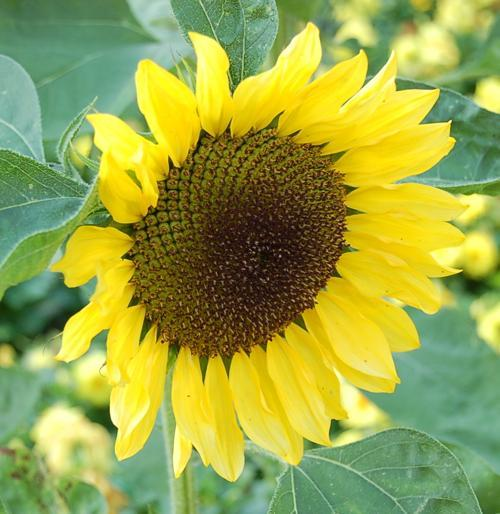

In [49]:
Image.open('flowers_dataset/test/53/image_05399.jpg')

In [ ]:
Image.open('flowers_dataset/test/72/image_00254.jpg')

In [ ]:
Image.open('flowers_dataset/test/73/image_01148.jpg')

Ahora que ya tenemos una noción de cómo se debería ver cada flor, veamos la imagen generada para nuestro primer modelo

100%|██████████| 512/512 [00:05<00:00, 89.52it/s]



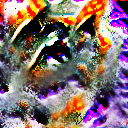

100%|██████████| 512/512 [00:05<00:00, 91.92it/s]



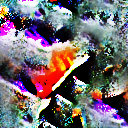

100%|██████████| 512/512 [00:05<00:00, 92.26it/s]



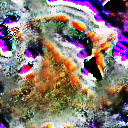

In [53]:
_ = render.render_vis(base_alexnet, 'labels:53', show_inline=True, preprocess=False)
_ = render.render_vis(base_alexnet, 'labels:72', show_inline=True, preprocess=False)
_ = render.render_vis(base_alexnet, 'labels:73', show_inline=True, preprocess=False)

Comparemos con la imagen generada para el modelo entrenado a partir de los pesos de ImageNet

100%|██████████| 512/512 [00:05<00:00, 97.40it/s]



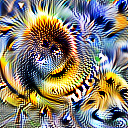

100%|██████████| 512/512 [00:05<00:00, 97.83it/s]



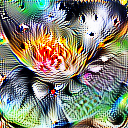

100%|██████████| 512/512 [00:05<00:00, 98.22it/s] 



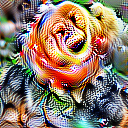

In [54]:
_ = render.render_vis(finetuned_alexnet, 'labels:53', show_inline=True) # Notar que ya no usamos el parámetro preprocess=False
_ = render.render_vis(finetuned_alexnet, 'labels:72', show_inline=True) # esto se debe a que sí queremos que se aplique la normalización
_ = render.render_vis(finetuned_alexnet, 'labels:73', show_inline=True) # sobre la imagen generada

La diferencia es más que evidente. En el primer caso es difícil distinguir algo, mientras que en el caso del modelo pre-entrenado se aprecian cláramente los colores y texturas asociados a las flores elegimos. Esta mejor representación interna explica la diferencia en resultados de ambos modelos.

**Conclusion**: Si no se tienen suficientes datos, es recomendable entrenar nuestro modelo a partir de un modelo preentrenado.

## Attribution

Consiste en determinar qué elementos del input contribuyeron más al valor del output.

Utilizaremos la libería torchray que implementa la técnica [Extremal Perturbations](https://arxiv.org/pdf/1910.08485.pdf) que discutimos en clases.

Recordemos que el método Extremal Perturbation consiste en, dada un área fija, encontrar una máscara que aplicada sobre el input maximiza la respuesta de una clase de interés.

In [ ]:
!pip install torchray

     |████████████████████████████████| 378kB 10.2MB/s 
  Created wheel for torchray: filename=torchray-1.0.0.2-cp36-none-any.whl size=444028 sha256=fc7864a6f9062f80811750cc849c48e3d973a4d04778b31115029ed77f6e365a
  Stored in directory: /root/.cache/pip/wheels/49/21/6d/e6794f79658b66a0775b164fdd274b81a4c96e4eab5baaacb0
Successfully built torchray


`torchray` implementa múltiples métodos de *attribution*, nosotros usaremos las funciones que se encuentran en `torchay.attribution.extremal_perturbation`

Puden ver la documentación completa en el siguiente [link](https://facebookresearch.github.io/TorchRay/attribution.html)

In [45]:
from torchray.attribution.extremal_perturbation import extremal_perturbation # importamos el método
from torchray.benchmark import get_example_data, plot_example # importamos utilidades para conseguir un ejemplo y desplegarlo

La función `get_example_data` retorna un modelo (en nuestro caso vamos a descartarlo porque ya tenemos cargados los modelos que queremos probar), una imagen de input y 2 categorías presentes en la imagen.



In [13]:
import requests
import inspect

def override_headers(func, global_headers):
    def wrapper(*args, **kwargs):
        bound = sig.bind(*args, **kwargs)
        bound.apply_defaults()
        bound.arguments.setdefault('headers', {}).update(global_headers)
        return func(*bound.args, **bound.kwargs)

    sig = inspect.signature(func)
    return wrapper

requests.get = override_headers(requests.get, {'User-Agent': 'Mozilla/5.0'})

In [ ]:
import requests

r = requests.get('https://upload.wikimedia.org/wikipedia/commons/thumb/7/7f/Arthur_Heyer_-_Dog_and_Cats.jpg/592px-Arthur_Heyer_-_Dog_and_Cats.jpg')
print(r.headers)
r.content

In [46]:
_, x, category_id_1, category_id_2 = get_example_data()

La función `extremal_perturbation` recibe entre sus parámetros un modelo, el input que queremos analizar, la categoría de la clase que estamos buscando en el input, un flag de debug y una lista con las áreas que queremos probar.

### ImageNet

Veamos cómo funciona el método 

extremal_perturbation:
- target: 245
- areas: [0.12]
- variant: preserve
- max_iter: 800
- step/sigma: 7, 21
- image size: [1, 3, 224, 224]
- reward function: simple_reward
- Perturbation:
  - type: blur
  - num_levels: 8
  - pyramid shape: [8, 3, 224, 224]
- mask resolution:
  torch.Size([1, 1, 32, 32])
[0001/0800] [area:0.12 loss:4.38 reg:-242.37]


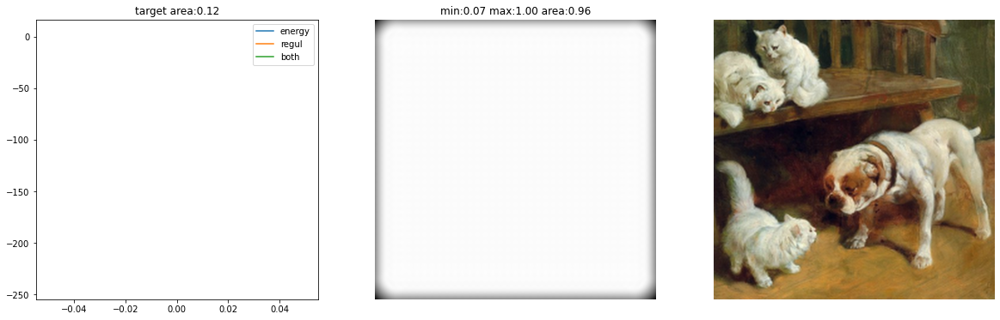

[0200/0800] [area:0.12 loss:4.01 reg:-39.90]


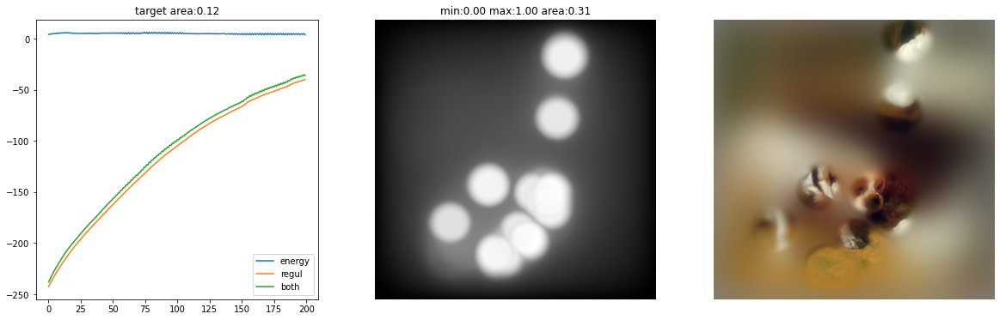

[0399/0800] [area:0.12 loss:4.56 reg:-23.07]


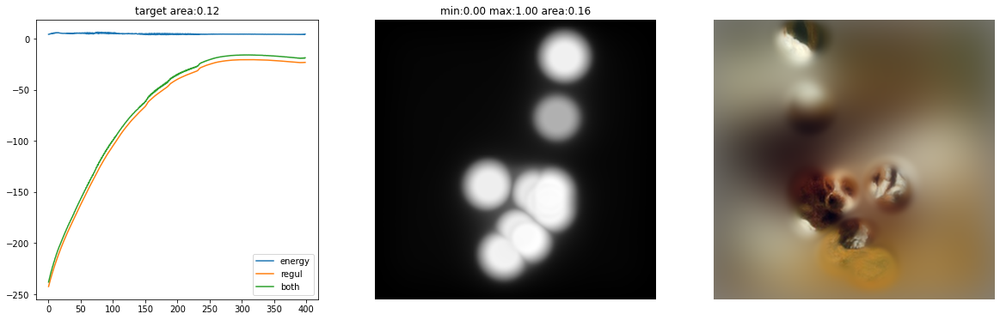

[0598/0800] [area:0.12 loss:4.02 reg:-29.16]


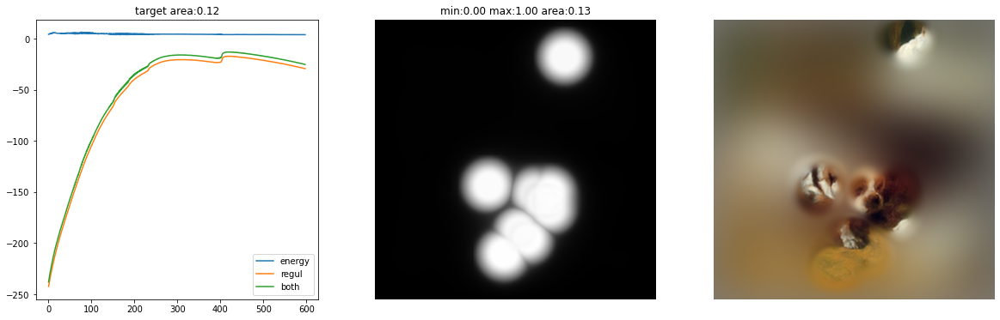

[0797/0800] [area:0.12 loss:3.94 reg:-58.13]


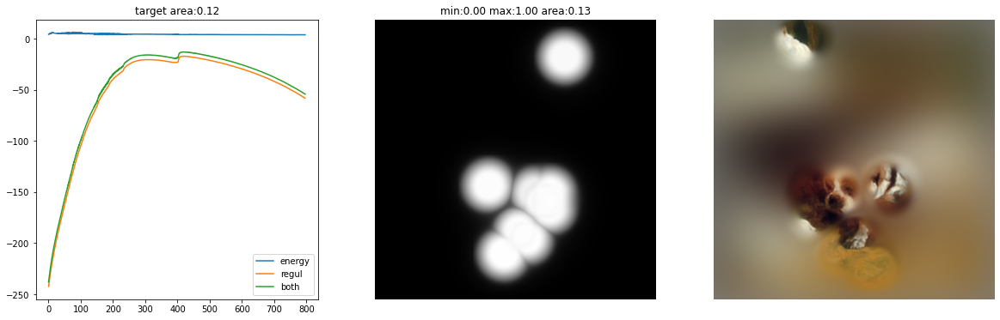

[0800/0800] [area:0.12 loss:3.93 reg:-58.74]


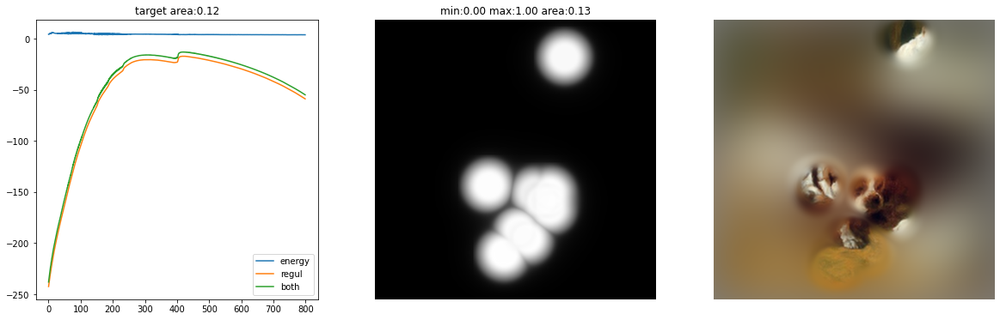

extremal_perturbation:
- target: 285
- areas: [0.05]
- variant: preserve
- max_iter: 800
- step/sigma: 7, 21
- image size: [1, 3, 224, 224]
- reward function: simple_reward
- Perturbation:
  - type: blur
  - num_levels: 8
  - pyramid shape: [8, 3, 224, 224]
- mask resolution:
  torch.Size([1, 1, 32, 32])
[0001/0800] [area:0.05 loss:0.83 reg:-262.99]


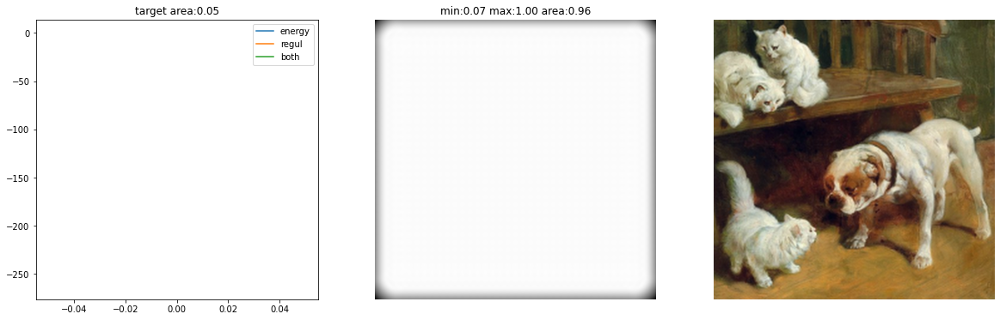

[0200/0800] [area:0.05 loss:6.43 reg:-26.54]


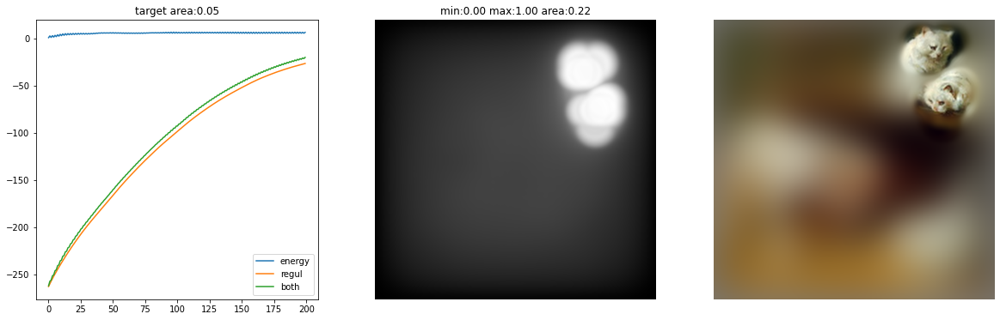

[0399/0800] [area:0.05 loss:5.75 reg:-10.60]


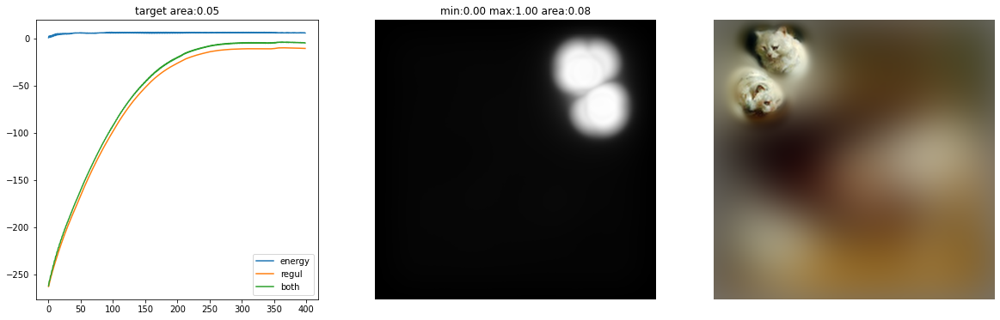

[0598/0800] [area:0.05 loss:6.27 reg:-15.70]


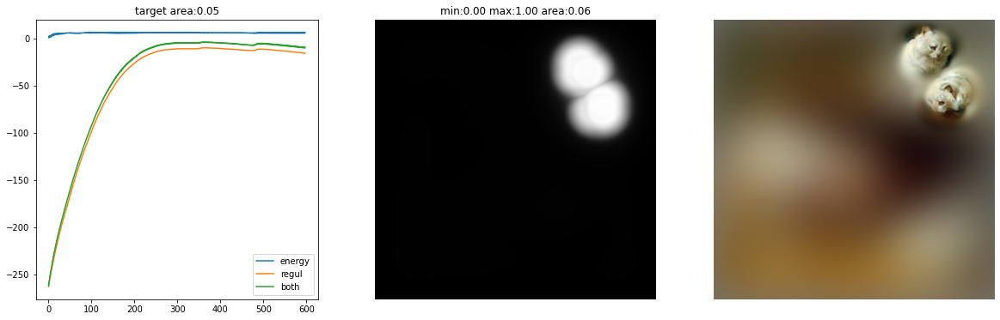

[0797/0800] [area:0.05 loss:5.25 reg:-29.13]


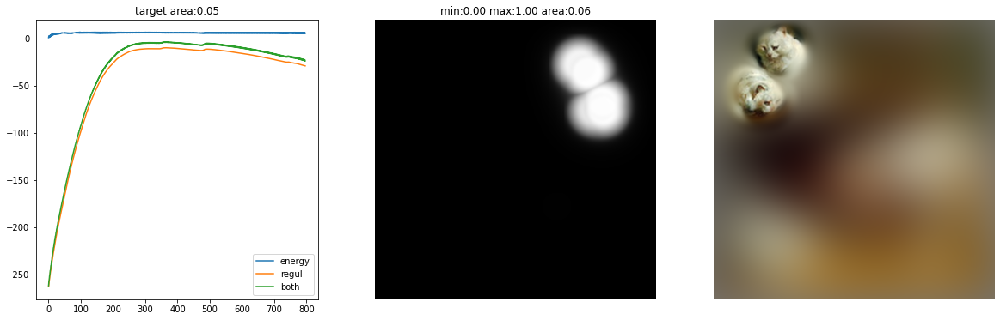

[0800/0800] [area:0.05 loss:6.32 reg:-29.37]


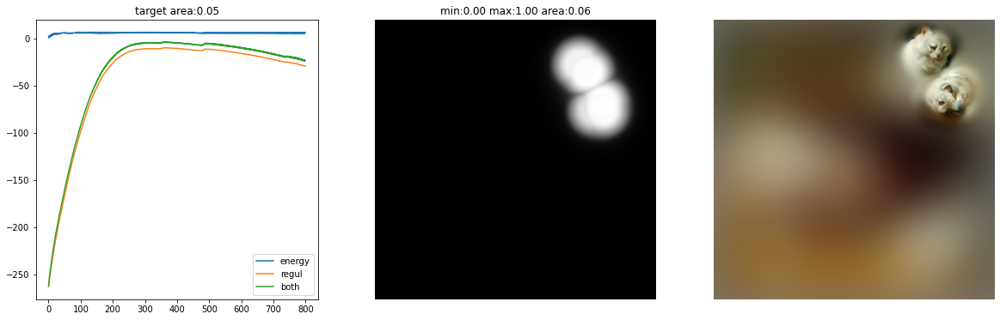

In [48]:
# Extremal perturbation backprop.
mask_1, _ = extremal_perturbation(
    alexnet, x, category_id_1,
    debug=True,
    areas=[0.12],
)

mask_2, _ = extremal_perturbation(
    alexnet, x, category_id_2,
    debug=True,
    areas=[0.05],
)

Se aprecia que para las 2 categorías (*French Bulldog* y *Egyptian Cat*) las máscaras encontradas corresponden efectivamente a evidencia de sus clases, por lo que el modelo se está fijando en los elementos correctos para tomar sus decisiones.

### Flower Dataset

Comparemos ahora en qué se fija el modelo que entrenamos para el Flower dataset entrenado desde 0 vs el modelo con fine tune.

Veamos una imagen del set de train, donde ambos modelos tienen rendimiento casi perfecto.

extremal_perturbation:
- target: 0
- areas: [0.2]
- variant: preserve
- max_iter: 800
- step/sigma: 7, 21
- image size: [1, 3, 224, 224]
- reward function: simple_reward
- Perturbation:
  - type: blur
  - num_levels: 8
  - pyramid shape: [8, 3, 224, 224]
- mask resolution:
  torch.Size([1, 1, 32, 32])
[0001/0800] [area:0.20 loss:3.88 reg:-218.86]


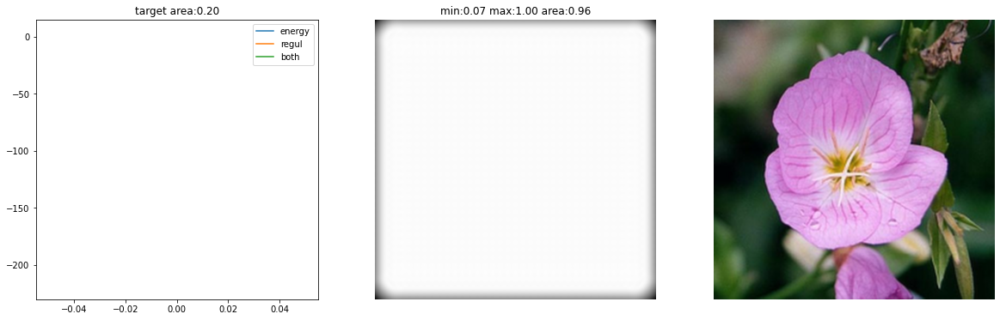

[0200/0800] [area:0.20 loss:22.20 reg:-40.97]


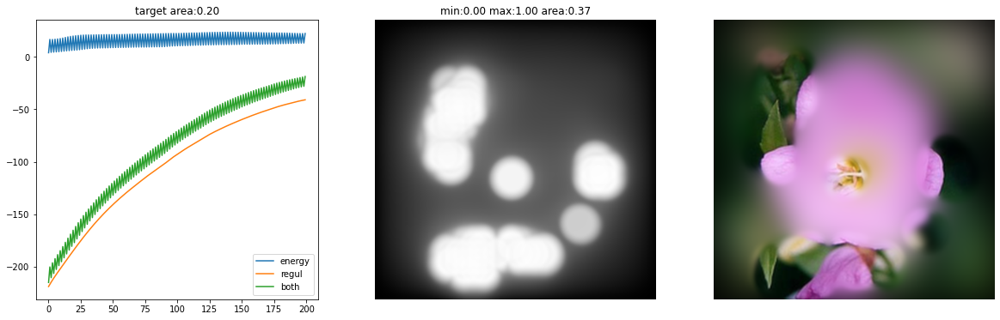

[0399/0800] [area:0.20 loss:17.63 reg:-30.39]


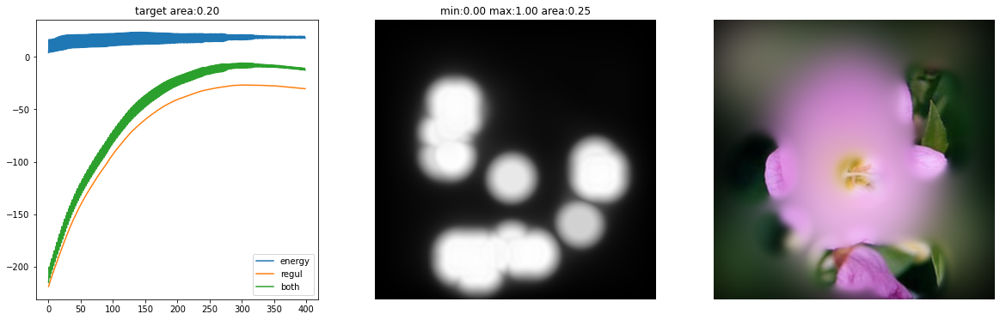

[0598/0800] [area:0.20 loss:19.97 reg:-55.88]


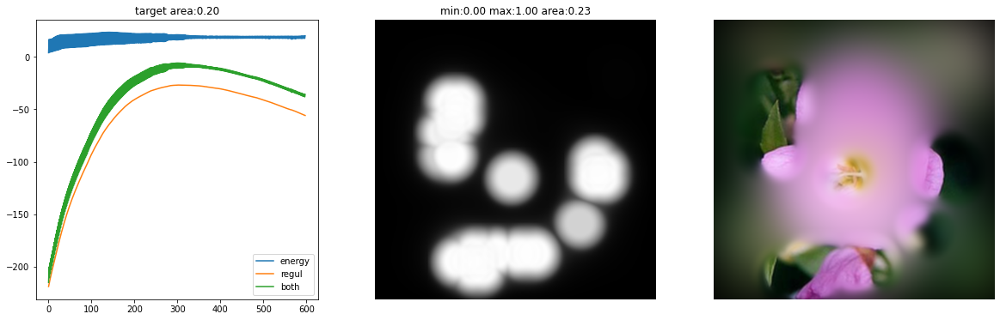

[0797/0800] [area:0.20 loss:17.29 reg:-105.96]


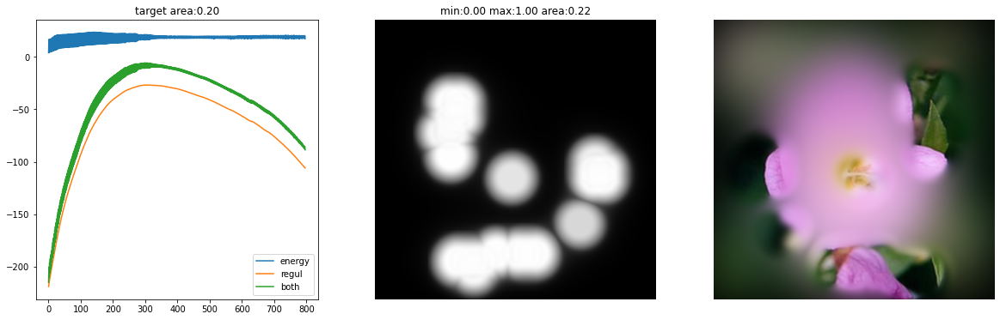

[0800/0800] [area:0.20 loss:19.87 reg:-107.10]


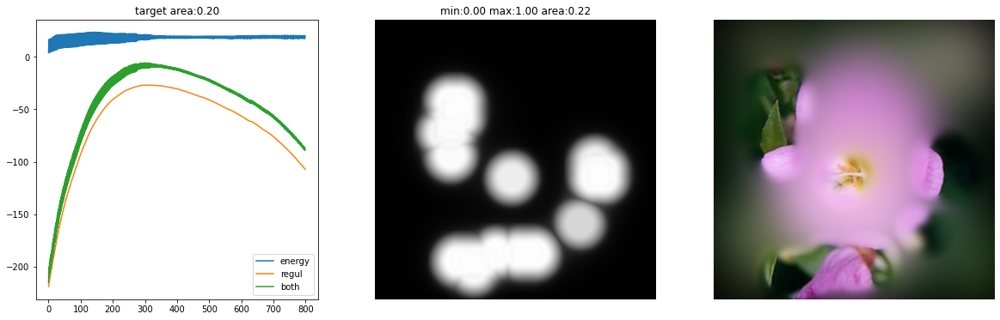

extremal_perturbation:
- target: 0
- areas: [0.2]
- variant: preserve
- max_iter: 800
- step/sigma: 7, 21
- image size: [1, 3, 224, 224]
- reward function: simple_reward
- Perturbation:
  - type: blur
  - num_levels: 8
  - pyramid shape: [8, 3, 224, 224]
- mask resolution:
  torch.Size([1, 1, 32, 32])
[0001/0800] [area:0.20 loss:17.42 reg:-218.86]


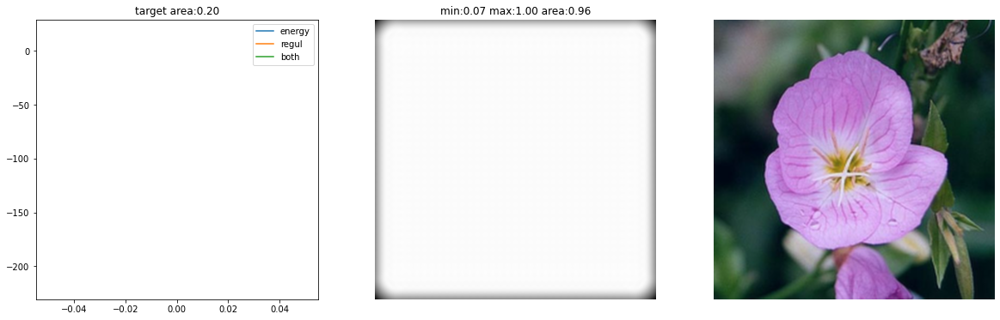

[0200/0800] [area:0.20 loss:37.09 reg:-76.98]


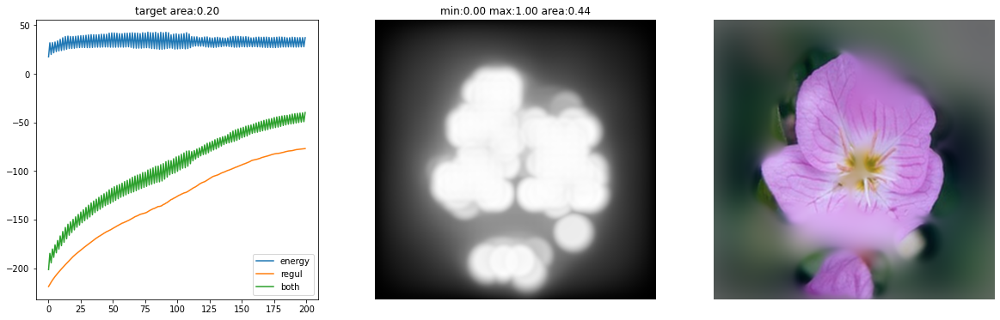

[0399/0800] [area:0.20 loss:19.75 reg:-44.99]


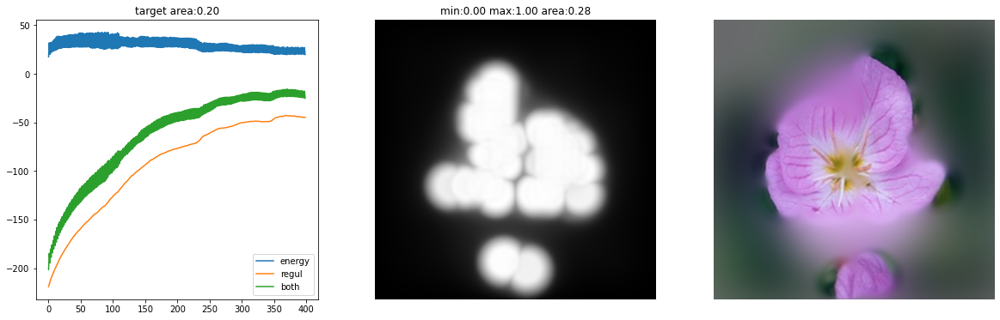

[0598/0800] [area:0.20 loss:20.12 reg:-54.52]


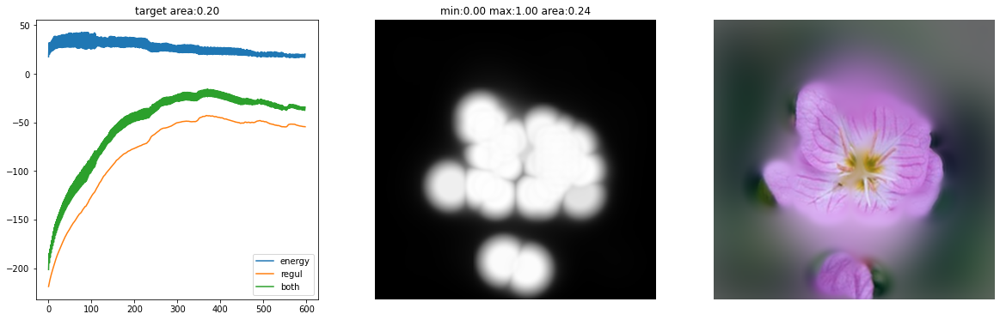

[0797/0800] [area:0.20 loss:16.34 reg:-69.69]


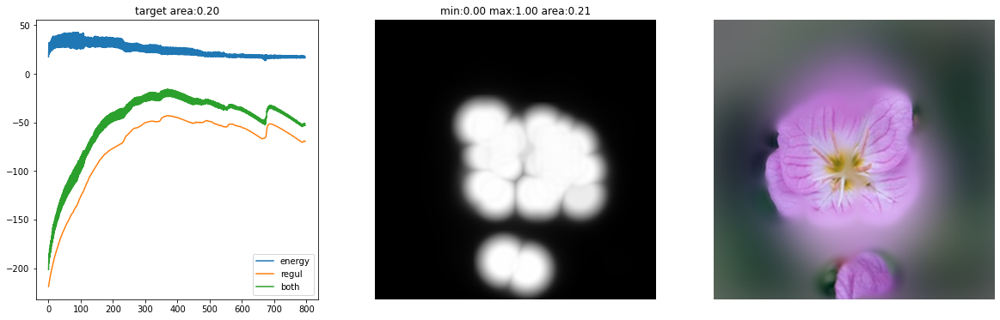

[0800/0800] [area:0.20 loss:18.73 reg:-70.37]


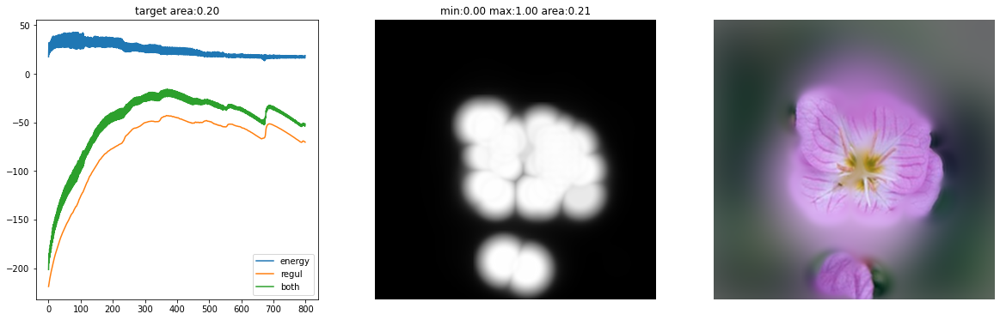

In [49]:
index = 0
x = ds_train[index][0].to(device).unsqueeze(0) # le agregamos una dimensión extra al inicio
label = ds_train[index][1]
base_alexnet_mask, _ = extremal_perturbation(
    base_alexnet, x, label,
    debug=True,
    areas=[0.2],
)
base_alexnet_predition = torch.argmax(base_alexnet(x), 1)

x = normalized_train_dataset[index][0].to(device).unsqueeze(0)
label = normalized_train_dataset[index][1]
finetuned_alexnet_mask, _ = extremal_perturbation(
    finetuned_alexnet, x, label,
    debug=True,
    areas=[0.2],
)
finetuned_alexnet_prediction = torch.argmax(finetuned_alexnet(x), 1)

In [50]:
print('label',label)
print('predicted base', base_alexnet_predition.item())
print('predicted finetune', finetuned_alexnet_prediction.item())

label 0
predicted base 0
predicted finetune 0


A pesar de que ambos predicen la clase correcta, se nota una diferencia en dónde están poniendo atención. El modelo base le da bastante importancia al fondo de la imagen, esto reafirma nuestra hipótesis de que está aprendiendo características específicas del set de entrenamiento más que generalizar. El modelo que entrenamos con finetuning, en cambio, le da la mayor importancia a la flor, lo que se ve reflejado en su buen rendimiento en el set de test.

Busquemos ahora una imagen del set de test que el modelo base clasifique mal y el modelo con finetuning clasifique bien y comparemos en qué se están fijando

In [51]:
def get_wrong_indices(model, dataloader): # función auxiliar para encontrar los índices de las imágenes mal clasificadas
    indices = []
    predictions = []
    with torch.no_grad():
        for x, target in dataloader:
            x = x.to(device)
            target = target.to(device)
            output = model(x)
            pred = output.argmax(dim=1)
            wrong = pred != target
            indices.append(wrong)
            predictions.append(pred)
    indices = torch.cat(indices, dim=0)
    indices = indices.squeeze() # remove extra dimension
    indices = torch.nonzero(indices)
    return indices

In [52]:
def view_example(dataset, target_label): # función auxiliar para visualizar una imagen de la clase target_label
    index = dataset.imgs_to_class.index(target_label)
    image = dataset[index][0]
    plt.imshow(image.cpu().numpy().transpose(1,2,0))

In [53]:
base_alexnet_mistakes = get_wrong_indices(base_alexnet, test_dl)
finetuned_alexnet_mistakes = get_wrong_indices(finetuned_alexnet, normalized_test_dl)

In [54]:
for index in base_alexnet_mistakes:             # revisamos todos los índices de clasificaciones erróneas en el modelo base
    if index not in finetuned_alexnet_mistakes: # si encontramos uno que no esté en los errores del modelo con finetune
        break                                   # paramos de buscar (en index está el valor que buscamos)
index = int(index)                              # lo transformamos de tensor a int

extremal_perturbation:
- target: 1
- areas: [0.2]
- variant: preserve
- max_iter: 800
- step/sigma: 7, 21
- image size: [1, 3, 224, 224]
- reward function: simple_reward
- Perturbation:
  - type: blur
  - num_levels: 8
  - pyramid shape: [8, 3, 224, 224]
- mask resolution:
  torch.Size([1, 1, 32, 32])
[0001/0800] [area:0.20 loss:-10.88 reg:-218.86]


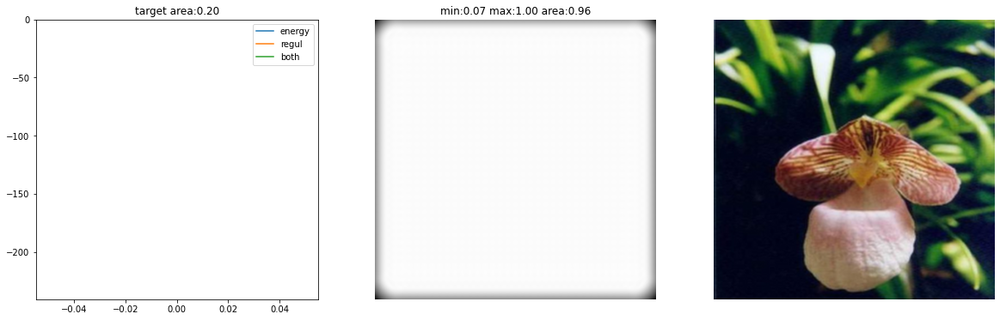

[0200/0800] [area:0.20 loss:-3.15 reg:-41.39]


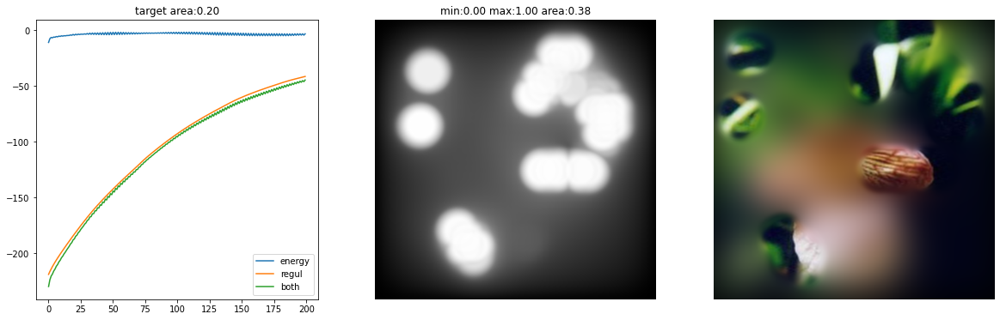

[0399/0800] [area:0.20 loss:-7.82 reg:-30.61]


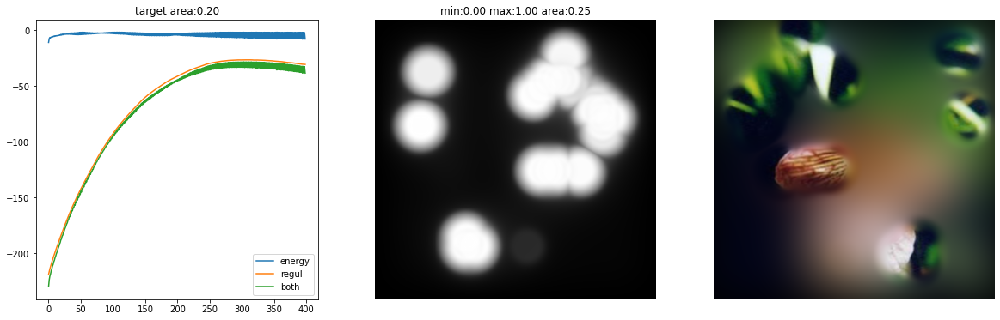

[0598/0800] [area:0.20 loss:-2.38 reg:-54.47]


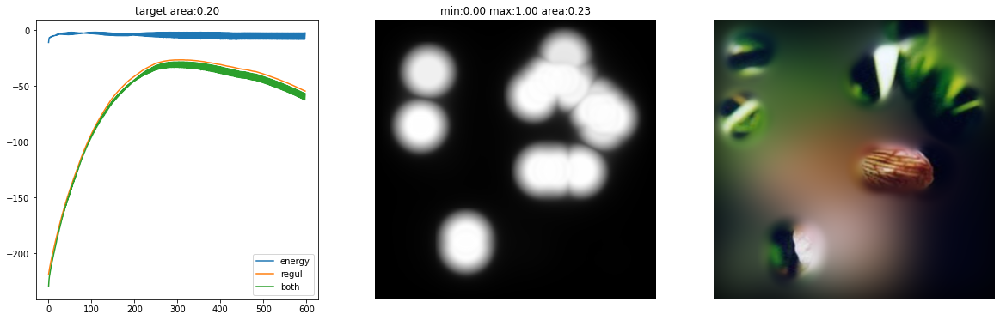

[0797/0800] [area:0.20 loss:-8.52 reg:-105.85]


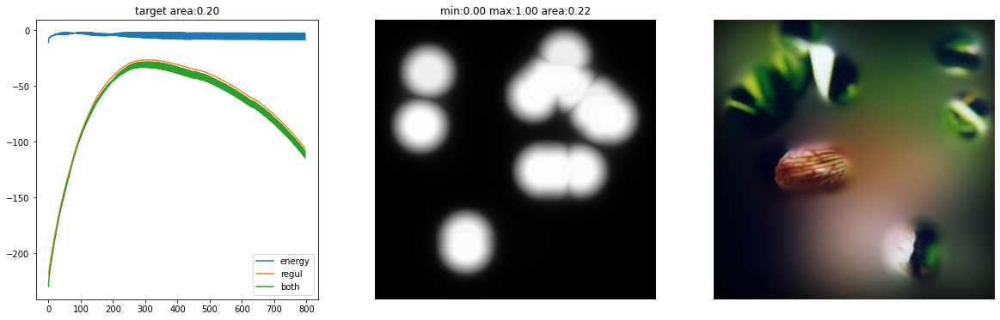

[0800/0800] [area:0.20 loss:-2.41 reg:-107.00]


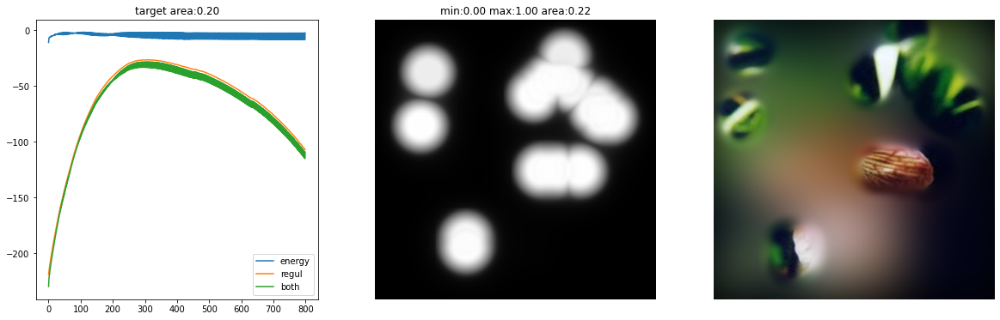

extremal_perturbation:
- target: 1
- areas: [0.2]
- variant: preserve
- max_iter: 800
- step/sigma: 7, 21
- image size: [1, 3, 224, 224]
- reward function: simple_reward
- Perturbation:
  - type: blur
  - num_levels: 8
  - pyramid shape: [8, 3, 224, 224]
- mask resolution:
  torch.Size([1, 1, 32, 32])
[0001/0800] [area:0.20 loss:6.69 reg:-218.86]


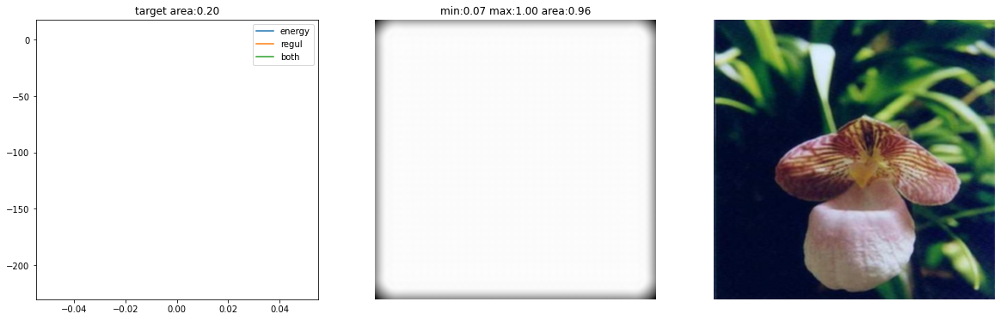

[0200/0800] [area:0.20 loss:43.69 reg:-91.01]


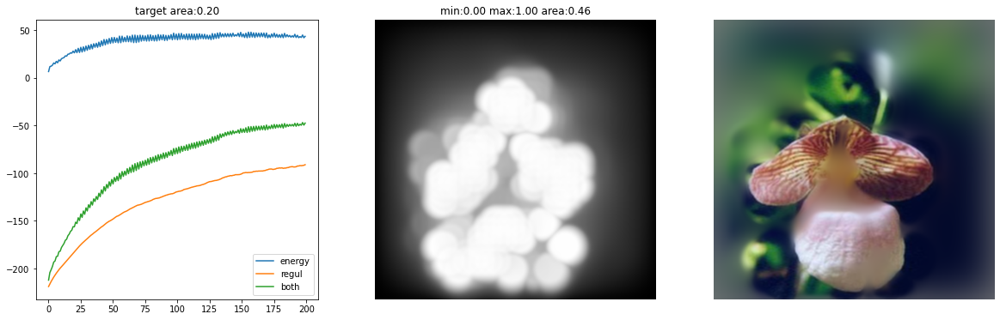

[0399/0800] [area:0.20 loss:47.89 reg:-92.12]


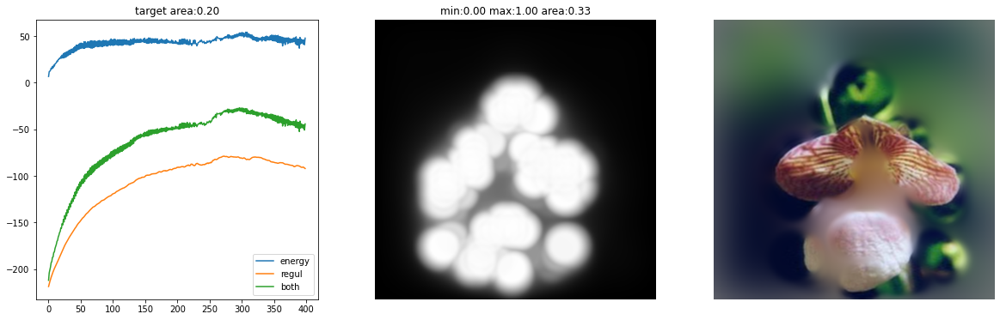

[0598/0800] [area:0.20 loss:31.61 reg:-65.39]


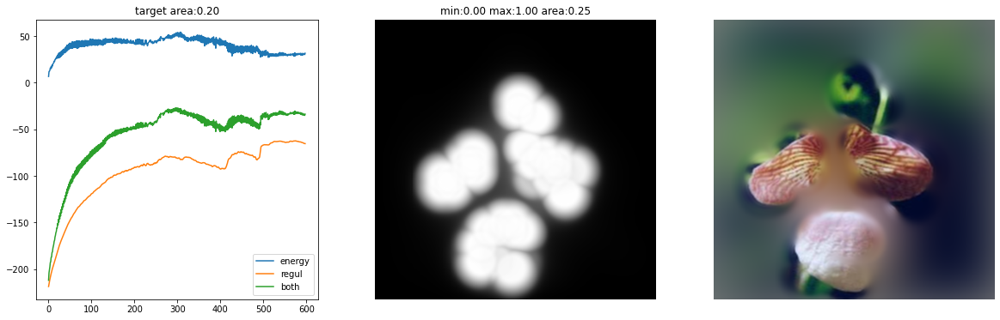

[0797/0800] [area:0.20 loss:28.34 reg:-108.32]


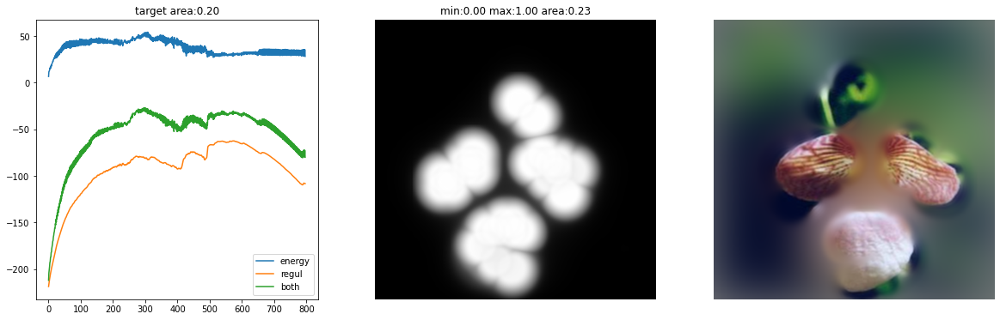

[0800/0800] [area:0.20 loss:35.64 reg:-109.17]


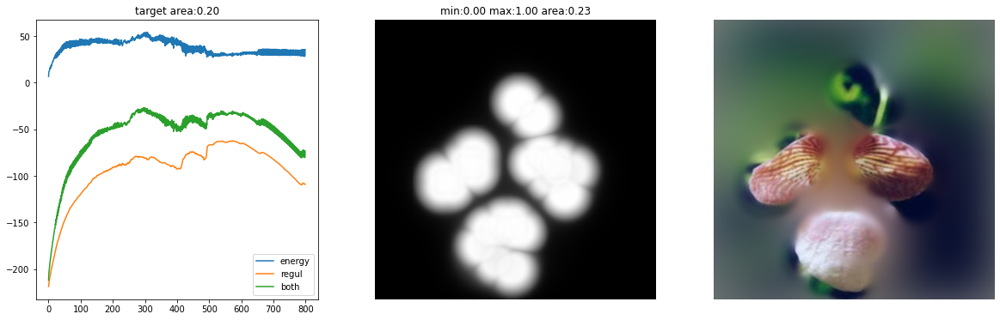

In [55]:
x = ds_test[index][0].to(device).unsqueeze(0) # le agregamos una dimensión extra al inicio
label = ds_test[index][1]

base_alexnet_mask, _ = extremal_perturbation(
    base_alexnet, x, label,
    debug=True,
    areas=[0.2],
)
base_alexnet_predition = int(torch.argmax(base_alexnet(x), 1))

x = normalized_test_dataset[index][0].to(device).unsqueeze(0)
label = normalized_test_dataset[index][1]
finetuned_alexnet_mask, _ = extremal_perturbation(
    finetuned_alexnet, x, label,
    debug=True,
    areas=[0.2],
)
finetuned_alexnet_prediction = int(torch.argmax(finetuned_alexnet(x), 1))

In [56]:
print('label', label)
print('predicted base', base_alexnet_predition)
print('predicted finetune', finetuned_alexnet_prediction)

label 1
predicted base 76
predicted finetune 1


Nuevamente vemos que para la clase correcta, el modelo base no se fija totalmente en la flor si no que le da importancia a información del fondo. El modelo con finetune le da la mayor importancia a la flor.

El modelo base predijo erróneamente la clase 28, para esa foto, en vez de la 0.

Veamos cómo se una flor de la clase 28

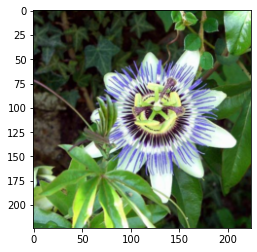

In [60]:
view_example(ds_test, base_alexnet_predition)

A simple vista no se parece mucho a la flor de input, por lo que cuesta entender por qué se confundió el modelo.

Veamos qué elementos de la imagen le hicieron pensar al modelo que se trataba de esa clase

extremal_perturbation:
- target: 76
- areas: [0.2]
- variant: preserve
- max_iter: 800
- step/sigma: 7, 21
- image size: [1, 3, 224, 224]
- reward function: simple_reward
- Perturbation:
  - type: blur
  - num_levels: 8
  - pyramid shape: [8, 3, 224, 224]
- mask resolution:
  torch.Size([1, 1, 32, 32])
[0001/0800] [area:0.20 loss:-3.77 reg:-218.86]


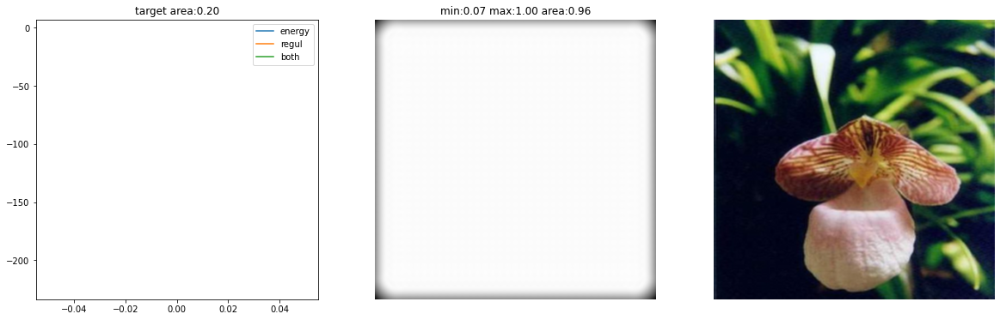

[0200/0800] [area:0.20 loss:14.66 reg:-46.91]


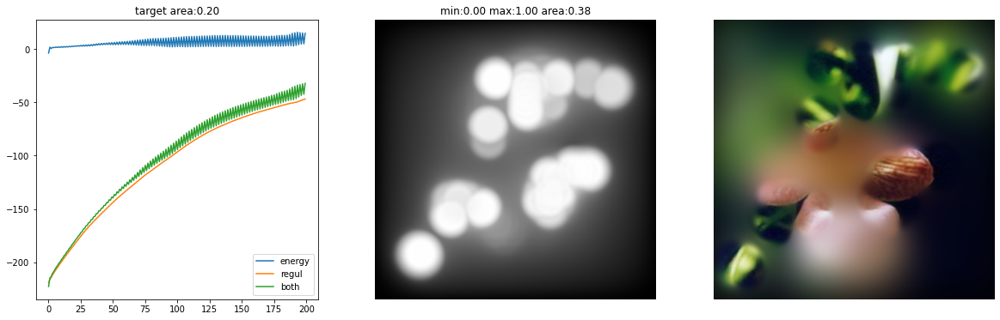

[0399/0800] [area:0.20 loss:7.91 reg:-37.58]


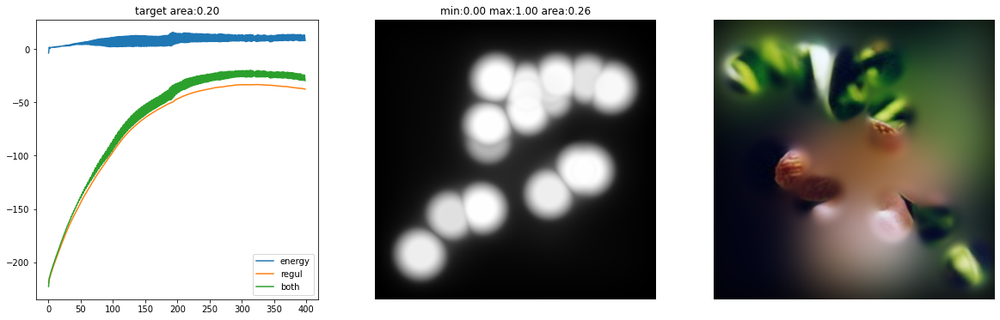

[0598/0800] [area:0.20 loss:10.41 reg:-66.77]


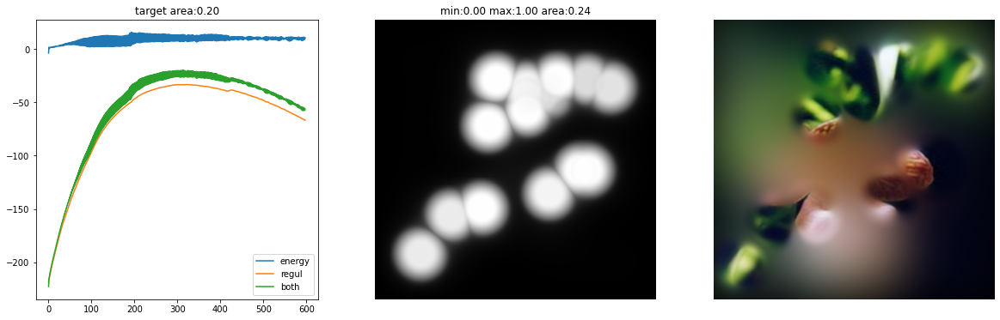

[0797/0800] [area:0.20 loss:8.18 reg:-123.90]


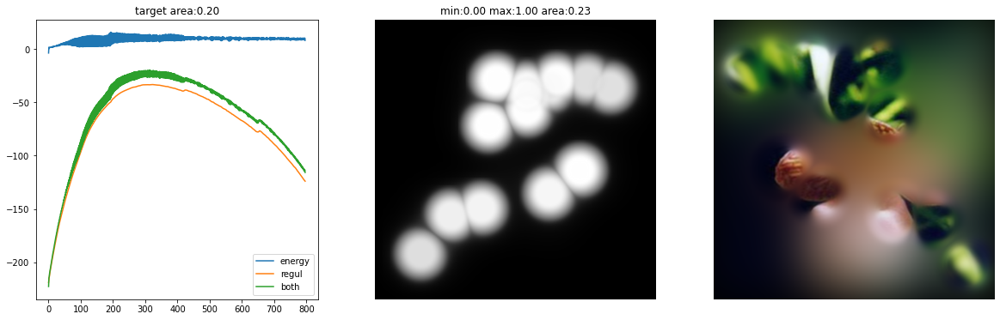

[0800/0800] [area:0.20 loss:10.16 reg:-125.04]


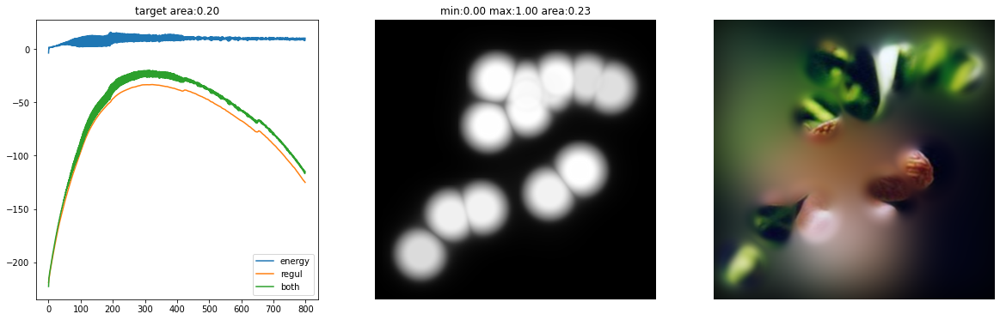

In [61]:
x = ds_test[index][0].to(device).unsqueeze(0) # le agregamos una dimensión extra al inicio
label = ds_test[index][1]

base_alexnet_mask, _ = extremal_perturbation(
    base_alexnet, x, base_alexnet_predition, # notar que acá cambiamos la clase real por la clase predicha
    debug=True,
    areas=[0.2],
)

Finalmente, el método nos muestra que para el modelo base fue muy importante la presencia de hojas que no forman parte de la flor. Esto nos confirma que el modelo no aprendió a diferenciar flores basándose en los atributos visuales de las mismas, si no que formó correlaciones equivocadas entre el fondo de la imagen y el tipo de flor.

El experimento anterior nos demuestra la utilidad de los métodos de attribution para entender las decisiones que toman los modelos que entrenamos y plantearnos formas de corregir los errores en su aprendizaje.

## Actividades:


###1
Escoja una de las arquitecturas entre vgg19, googlenet y resnet50 y modifíquela según las instrucciones a continuación para que sea compatible con la cantidad de clases en el dataset de las flores. 

```python
import torch
import torchvision.models as models
import torch.nn as nn

### VGG19
model = models.vgg19()
model.classifier = nn.Sequential(
            nn.Linear(25088, 4096),
            nn.ReLU(inplace=True),
            nn.Dropout(),
            nn.Linear(4096, 4096),
            nn.ReLU(inplace=True),
            nn.Dropout(),
            nn.Linear(4096, 102),
        )

### GoogLeNet
model = models.googlenet(aux_logits=False) # por simplicidad no vamos a agregar los clasificadores auxiliares
model.fc = nn.Linear(1024, 102)

### Resnet50
model = models.resnet50()
model.fc = nn.Linear(2048, 102)
```
   
   Una vez creado el modelo modificado, descargue los pesos que correspondan a la arquitectura seleccionada y cárguelos en su modelo. (Estos pesos son el resultado de 40 épocas)

`!wget https://www.dropbox.com/s/85oif545obsryc8/base_vgg19.pth`

`!wget https://www.dropbox.com/s/mz5053cquzw5zeh/base_googlenet.pth`

`!wget https://www.dropbox.com/s/q308auknnt8szzw/base_resnet50.pth`

Finalmente reporte los resultados obtenidos en el set de train y test. 

**IMPORTANTE**: Estos pesos se obtuvieron sin normalizar el input, por lo que es importante que no aplique la normalización en las transformaciones del input o la métrica de rendimieto será errónea. 




In [83]:
model = models.vgg19()
model.classifier = nn.Sequential(
    nn.Linear(25088, 4096),
    nn.ReLU(inplace=True),
    nn.Dropout(),
    nn.Linear(4096, 4096),
    nn.ReLU(inplace=True),
    nn.Dropout(),
    nn.Linear(4096, 102),
)

model.to(device)

weights = torch.load("base_vgg19.pth")
model.load_state_dict(weights)
_ = model.eval()


### 2

Visualice 4 canales de la primera capa convolucional, una de al medio y la última capa convolucional para su modelo entrenado. ¿Cómo son los features? ¿Se aprecia un aumento en la complejidad de los features a medida que las capas son más profundas?

  Recuerde que si no normaliza el input, entonces debe entregar el parámetro `preprocess=False` a las funciones que generan las imágenes.

In [64]:
get_model_layers(model)

['features',
 'features_0',
 'features_1',
 'features_2',
 'features_3',
 'features_4',
 'features_5',
 'features_6',
 'features_7',
 'features_8',
 'features_9',
 'features_10',
 'features_11',
 'features_12',
 'features_13',
 'features_14',
 'features_15',
 'features_16',
 'features_17',
 'features_18',
 'features_19',
 'features_20',
 'features_21',
 'features_22',
 'features_23',
 'features_24',
 'features_25',
 'features_26',
 'features_27',
 'features_28',
 'features_29',
 'features_30',
 'features_31',
 'features_32',
 'features_33',
 'features_34',
 'features_35',
 'features_36',
 'avgpool',
 'classifier',
 'classifier_0',
 'classifier_1',
 'classifier_2',
 'classifier_3',
 'classifier_4',
 'classifier_5',
 'classifier_6']

100%|██████████| 512/512 [00:04<00:00, 114.07it/s]



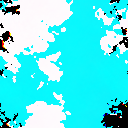

100%|██████████| 512/512 [00:04<00:00, 114.06it/s]



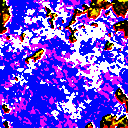

100%|██████████| 512/512 [00:04<00:00, 117.79it/s]



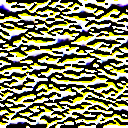

100%|██████████| 512/512 [00:05<00:00, 88.17it/s]



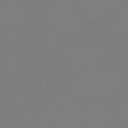

100%|██████████| 512/512 [00:07<00:00, 72.94it/s]



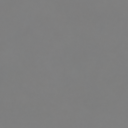

In [79]:
_ = render.render_vis(model, 'features_0:0', show_inline=True, preprocess=False)
_ = render.render_vis(model, 'features_0:1', show_inline=True, preprocess=False)
_ = render.render_vis(model, 'features_0:2', show_inline=True, preprocess=False)
_ = render.render_vis(model, 'features_20:0', show_inline=True, preprocess=False)
_ = render.render_vis(model, 'features_36:0', show_inline=True, preprocess=False)

# No se aprecia un aumento de la complejidad usando feature visualization en capas intermedias/finales

### 3

Escoja 3 flores y visualice la imagen generada para cada una de las flores en su modelo entrenado. ¿Tienen sentido las imágenes generadas?

  Recuerde que si no normaliza el input, entonces debe entregar el parámetro `preprocess=False` a las funciones que generan las imágenes.

100%|██████████| 512/512 [00:08<00:00, 59.53it/s]



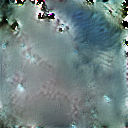

100%|██████████| 512/512 [00:08<00:00, 59.82it/s]



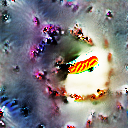

100%|██████████| 512/512 [00:08<00:00, 57.95it/s]



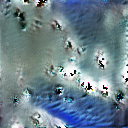

In [81]:
_ = render.render_vis(model, 'labels:53', show_inline=True, preprocess=False)
_ = render.render_vis(model, 'labels:72', show_inline=True, preprocess=False)
_ = render.render_vis(model, 'labels:73', show_inline=True, preprocess=False)

# las imagenes generadas no tienen sentido con respecto a las categorias


### 4
Ocupe la versión preentrenada en ImageNet del modelo que escogió y entrene por al menos 20 épocas el modelo en el Flower dataset. ¿Qué resultados obtiene en train y test?

  El siguiente código muestra las modificaciones necesarias al modelo para utilizar los pesos preentrenados como base

```python
import torch
import torchvision.models as models
import torch.nn as nn

### VGG19
model = models.vgg19(pretrained=True)
for param in model.parameters():
    param.requires_grad = False
model.classifier = nn.Sequential(
            nn.Linear(25088, 4096),
            nn.ReLU(inplace=True),
            nn.Dropout(),
            nn.Linear(4096, 4096),
            nn.ReLU(inplace=True),
            nn.Dropout(),
            nn.Linear(4096, 102),
        )

### GoogLeNet
model = models.googlenet(pretrained=True)
for param in model.parameters():
    param.requires_grad = False
model.fc = nn.Linear(1024, 102)

### Resnet50
model = models.resnet50(pretrained=True)
for param in model.parameters():
    param.requires_grad = False
model.fc = nn.Linear(2048, 102)
```

  Se recomienda normalizar los datos para obtener los mejores resultados

```python
from torchvision.transforms import Compose, ToTensor, Resize, Normalize

mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]
transforms = Compose([Resize((224, 224)), ToTensor(), Normalize(mean, std)])
```

  Si decide normalizar los datos, recuerde que debe omitir el parámetro `preprocess` en las funciones de visualización.

   Se recomienda conectar Colab con su Google Drive (la cuenta UC provee almacenamiento *ilimitado*) y guardar los pesos periódicamente para no perder su avance.

   Considere que el número de parámetros y operaciones de cada arquitectura influye en el tiempo de entrenamiento e inferencia del modelo, por lo que hay arquitecturas que tardarán más que otras en completar las 20 épocas.





In [4]:
import torch
import torchvision.models as models
import torch.nn as nn
from torch.utils.data import DataLoader
from torch.optim import SGD
from torchvision.transforms import Compose, ToTensor, Resize, Normalize
from lucent.optvis import render, param, transform, objectives
from lucent.modelzoo.util import get_model_layers

# VGG19
device = torch.device('cuda:0')
model_pretrained = models.vgg19(pretrained=True)

for param in model_pretrained.parameters():
    param.requires_grad = False

model_pretrained.classifier = nn.Sequential(
    nn.Linear(25088, 4096),
    nn.ReLU(inplace=True),
    nn.Dropout(),
    nn.Linear(4096, 4096),
    nn.ReLU(inplace=True),
    nn.Dropout(),
    nn.Linear(4096, 102),
)

model_pretrained.to(device)
loss_function = nn.CrossEntropyLoss().to(device)
model_pretrained

VGG(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): ReLU(inplace=True)
    (2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (3): ReLU(inplace=True)
    (4): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (5): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (6): ReLU(inplace=True)
    (7): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (8): ReLU(inplace=True)
    (9): MaxPool2d(kernel_size=2, stride=2, padding=0, dilation=1, ceil_mode=False)
    (10): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace=True)
    (12): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (13): ReLU(inplace=True)
    (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (15): ReLU(inplace=True)
    (16): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padd

In [13]:
model_pretrained.load_state_dict(torch.load('finetuned_vgg19_lab3_3.pth'))

<All keys matched successfully>

In [14]:
optimizer = SGD(model_pretrained.parameters(), lr=0.00001, momentum=0.95)

In [3]:
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]
transforms = Compose([Resize((224, 224)), ToTensor(), Normalize(mean, std)])

ds_train = Flowers("flowers_dataset/train", transform=transforms)
train_dl = DataLoader(ds_train, batch_size=256)

ds_test = Flowers("flowers_dataset/test", transform=transforms)
test_dl = DataLoader(ds_test, batch_size=256)

In [15]:
model_pretrained.train()

for epoch in range(5):
    total_correctas = total_muestras = 0.0

    for x, target in train_dl:
        x = x.to(device)
        target = target.to(device)

        optimizer.zero_grad()
        output = model_pretrained(x)

        loss = loss_function(output, target)
        loss.backward()
        optimizer.step()

        preds = output.argmax(dim=1)

        total_correctas += (preds == target).sum()
        total_muestras += target.shape[0]
        accuracy = total_correctas/total_muestras * 100
        
        print(
            f'\rEpoca {epoch} '
            f'Loss: {loss:.2f} '
            f'Correctas: {total_correctas} '
            f'Total: {total_muestras} '
            f'Accuracy: {accuracy:.2f}%',
            end=''
        )

        del x, target, output, loss, preds
    print('')

# torch.save(model_pretrained.state_dict(), 'finetuned_vgg19_lab3_4.pth')

Epoca 0 Loss: 0.05 Correctas: 6212.0 Total: 7469.0 Accuracy: 83.17%
Epoca 1 Loss: 0.03 Correctas: 6198.0 Total: 7469.0 Accuracy: 82.98%
Epoca 2 Loss: 0.07 Correctas: 6182.0 Total: 7469.0 Accuracy: 82.77%
Epoca 3 Loss: 0.07 Correctas: 6209.0 Total: 7469.0 Accuracy: 83.13%
Epoca 4 Loss: 0.05 Correctas: 6253.0 Total: 7469.0 Accuracy: 83.72%


In [16]:
# test accuracy
total_correctas = 0.0
total_muestras = 0.0

model_pretrained.eval()

for x, target in test_dl:
    x = x.to(device)
    target = target.to(device)

    with torch.no_grad():
        output = model_pretrained(x)

        loss = loss_function(output, target)
        preds = output.argmax(dim=1)

        total_correctas += (preds == target).sum()
        total_muestras += target.shape[0]

        accuracy = 100 * total_correctas / total_muestras

        del x, target, output, preds, loss

        print(
            f'\rLoss: {loss:.2f} '
            f'Correctas: {total_correctas} '
            f'Total: {total_muestras} '
            f'Accuracy: {accuracy:.2f}%',
            end=''
        )

Loss: 0.88 Correctas: 3314.0 Total: 3831.0 Accuracy: 86.50%

### 5
Visualice las imágenes generadas para las 3 flores que escogió en la actividad 3 ahora en su nuevo modelo entrenado. Compare con las imágenes obtenidas en la actividad 3.

100%|██████████| 512/512 [00:10<00:00, 51.17it/s]



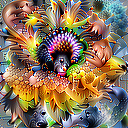

100%|██████████| 512/512 [00:08<00:00, 63.08it/s]



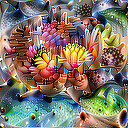

100%|██████████| 512/512 [00:07<00:00, 64.30it/s]



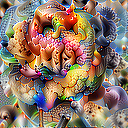

In [17]:
_ = render.render_vis(model_pretrained, 'labels:53', show_inline=True)
_ = render.render_vis(model_pretrained, 'labels:72', show_inline=True)
_ = render.render_vis(model_pretrained, 'labels:73', show_inline=True)